<a href="https://colab.research.google.com/github/prakash-tech89/Data-Science/blob/master/Wids_hackathon_climate_change_2022.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
#One time setup to copy data from local to drive which can be used anytime
#%cp -r  '/content/sample_data/wids-2022/*' '/content/drive/MyDrive/wids-2022/'

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [42]:
# Generic library
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns


# Others
%matplotlib inline
#cmap=sns.color_palette('Blues_r')
cmap=sns.color_palette("Spectral")

In [3]:
train_df=pd.read_csv("/content/drive/MyDrive/wids_hackathon/train.csv")
test_df=pd.read_csv("/content/drive/MyDrive/wids_hackathon/test.csv")
submission = pd.read_csv("/content/drive/MyDrive/wids_hackathon/sample_solution.csv")

In [4]:
print("Train size : rows",train_df.shape[0]," and columns",train_df.shape[1])
print("Test size : rows",test_df.shape[0]," and columns",test_df.shape[1])

Train size : rows 14919  and columns 64
Test size : rows 9705  and columns 63


In [5]:
train_df["source"] = "train"
test_df["source"] = "test"
df = pd.concat([train_df,test_df])

In [ ]:
#df.hist(grid=False,figsize=(100, 60),bins=30)

In [6]:
df.duplicated().sum()

0

In [7]:
df.isna().sum()

Year_Factor           0
State_Factor          0
building_class        0
facility_type         0
floor_area            0
                  ...  
max_wind_speed    21833
days_with_fog     20929
site_eui           9706
id                    1
source                0
Length: 65, dtype: int64

In [8]:
percent_missing = df.isnull().sum() * 100 / len(df)
missing_value_df = pd.DataFrame({'column_name': df.columns,
                                 'percent_missing': percent_missing})

In [9]:
missing_value_df.sort_values('percent_missing',ascending=False)

,column_name,percent_missing
direction_peak_wind_speed,direction_peak_wind_speed,88.819851
max_wind_speed,max_wind_speed,88.665530
direction_max_wind_speed,direction_max_wind_speed,88.665530
days_with_fog,days_with_fog,84.994314
site_eui,site_eui,39.416829
...,...,...
july_max_temp,july_max_temp,0.000000
august_min_temp,august_min_temp,0.000000
august_avg_temp,august_avg_temp,0.000000
august_max_temp,august_max_temp,0.000000


In [10]:
df.head(30)

,Year_Factor,State_Factor,building_class,facility_type,floor_area,year_built,energy_star_rating,ELEVATION,january_min_temp,january_avg_temp,january_max_temp,february_min_temp,february_avg_temp,february_max_temp,march_min_temp,march_avg_temp,march_max_temp,april_min_temp,april_avg_temp,april_max_temp,may_min_temp,may_avg_temp,may_max_temp,june_min_temp,june_avg_temp,june_max_temp,july_min_temp,july_avg_temp,july_max_temp,august_min_temp,august_avg_temp,august_max_temp,september_min_temp,september_avg_temp,september_max_temp,october_min_temp,october_avg_temp,october_max_temp,november_min_temp,november_avg_temp,november_max_temp,december_min_temp,december_avg_temp,december_max_temp,cooling_degree_days,heating_degree_days,precipitation_inches,snowfall_inches,snowdepth_inches,avg_temp,days_below_30F,days_below_20F,days_below_10F,days_below_0F,days_above_80F,days_above_90F,days_above_100F,days_above_110F,direction_max_wind_speed,direction_peak_wind_speed,max_wind_speed,days_with_fog,site_eui,id,source
0,1,State_1,Commercial,Grocery_store_or_food_market,61242.0,1942.0,11.0,2.4,36,50.5,68,35,50.589286,73,40,53.693548,80,41,55.5,78,46,56.854839,84,50,60.5,90,52,62.725806,84,52,62.16129,85,52,64.65,90,47,63.016129,83,43,53.8,72,36,49.274194,71,115,2960,16.59,0.0,0.0,56.972603,0.0,0.0,0.0,0.0,14.0,0.0,0.0,0.0,1.0,1.0,1.0,NaN,248.682615,0.0,train
1,1,State_1,Commercial,Warehouse_Distribution_or_Shipping_center,274000.0,1955.0,45.0,1.8,36,50.5,68,35,50.589286,73,40,53.693548,80,41,55.5,78,46,56.854839,84,50,60.5,90,52,62.725806,84,52,62.16129,85,52,64.65,90,47,63.016129,83,43,53.8,72,36,49.274194,71,115,2960,16.59,0.0,0.0,56.972603,0.0,0.0,0.0,0.0,14.0,0.0,0.0,0.0,1.0,NaN,1.0,12.0,26.500150,1.0,train
2,1,State_1,Commercial,Retail_Enclosed_mall,280025.0,1951.0,97.0,1.8,36,50.5,68,35,50.589286,73,40,53.693548,80,41,55.5,78,46,56.854839,84,50,60.5,90,52,62.725806,84,52,62.16129,85,52,64.65,90,47,63.016129,83,43,53.8,72,36,49.274194,71,115,2960,16.59,0.0,0.0,56.972603,0.0,0.0,0.0,0.0,14.0,0.0,0.0,0.0,1.0,NaN,1.0,12.0,24.693619,2.0,train
3,1,State_1,Commercial,Education_Other_classroom,55325.0,1980.0,46.0,1.8,36,50.5,68,35,50.589286,73,40,53.693548,80,41,55.5,78,46,56.854839,84,50,60.5,90,52,62.725806,84,52,62.16129,85,52,64.65,90,47,63.016129,83,43,53.8,72,36,49.274194,71,115,2960,16.59,0.0,0.0,56.972603,0.0,0.0,0.0,0.0,14.0,0.0,0.0,0.0,1.0,NaN,1.0,12.0,48.406926,3.0,train
4,1,State_1,Commercial,Warehouse_Nonrefrigerated,66000.0,1985.0,100.0,2.4,36,50.5,68,35,50.589286,73,40,53.693548,80,41,55.5,78,46,56.854839,84,50,60.5,90,52,62.725806,84,52,62.16129,85,52,64.65,90,47,63.016129,83,43,53.8,72,36,49.274194,71,115,2960,16.59,0.0,0.0,56.972603,0.0,0.0,0.0,0.0,14.0,0.0,0.0,0.0,1.0,1.0,1.0,NaN,3.899395,4.0,train
5,1,State_1,Commercial,Warehouse_Selfstorage,119900.0,1956.0,NaN,2.4,36,50.5,68,35,50.589286,73,40,53.693548,80,41,55.5,78,46,56.854839,84,50,60.5,90,52,62.725806,84,52,62.16129,85,52,64.65,90,47,63.016129,83,43,53.8,72,36,49.274194,71,115,2960,16.59,0.0,0.0,56.972603,0.0,0.0,0.0,0.0,14.0,0.0,0.0,0.0,1.0,1.0,1.0,NaN,6.597715,5.0,train
6,1,State_1,Commercial,Warehouse_Nonrefrigerated,91367.0,1982.0,56.0,2.4,36,50.5,68,35,50.589286,73,40,53.693548,80,41,55.5,78,46,56.854839,84,50,60.5,90,52,62.725806,84,52,62.16129,85,52,64.65,90,47,63.016129,83,43,53.8,72,36,49.274194,71,115,2960,16.59,0.0,0.0,56.972603,0.0,0.0,0.0,0.0,14.0,0.0,0.0,0.0,1.0,1.0,1.0,NaN,12.817841,6.0,train
7,1,State_1,Commercial,Warehouse_Nonrefrigerated,50422.0,1947.0,99.0,2.4,36,50.5,68,35,50.589286,73,40,53.693548,80,41,55.5,78,46,56.854839,84,50,60.5,90,52,62.725806,84,52,62.16129,85,52,64.65,90,47,63.016129,83,43,53.8,72,36,49.274194,71,115,2960,16.59,0.0,0.0,56.972603,0.0,0.0,0.0,0.0,14.0,0.0,0.0,0.0,1.0,1.0,1.0,NaN,22.392014,7.0,train
8,1,State_1,Commercial,Office_Uncategorized,122020.0,1929.0,98.0,2.4,36,50.5,68,35,50.589286,73,40,53.693548,80,41,55.5,78,46,56.854839,84,50,60.5,90,52,62.725806,84,52,62.16129,85,52,64.65,90,47,63.016129,83,43,53.8,72,36,49.274194,71,11

In [11]:
df.facility_type.value_counts()

Office_Uncategorized                         6785
Multifamily_Uncategorized                    5579
Education_Other_classroom                    2116
Lodging_Hotel                                1252
2to4_Unit_Building                            966
5plus_Unit_Building                           689
Education_Uncategorized                       666
Retail_Uncategorized                          646
Education_College_or_university               603
Commercial_Other                              601
Grocery_store_or_food_market                  349
Warehouse_Nonrefrigerated                     324
Mixed_Use_Predominantly_Commercial            306
Mixed_Use_Commercial_and_Residential          292
Nursing_Home                                  279
Religious_worship                             271
Lodging_Dormitory_or_fraternity_sorority      269
Office_Medical_non_diagnostic                 252
Health_Care_Inpatient                         208
Warehouse_Distribution_or_Shipping_center     182


In [12]:
df.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
Year_Factor,24624.0,5.568389,1.561877,1.000000,5.000000,6.000000,7.000000,7.000000e+00
floor_area,24624.0,186451.002652,293280.796776,943.000000,51577.000000,93501.000000,209728.000000,6.353396e+06
year_built,23524.0,1959.055518,49.007251,0.000000,1926.000000,1965.000000,1989.000000,2.016000e+03
energy_star_rating,18551.0,64.196054,27.845149,0.000000,44.000000,72.000000,87.000000,1.000000e+02
ELEVATION,24624.0,135.447620,194.054879,-6.400000,15.800000,52.700000,198.100000,1.924500e+03
...,...,...,...,...,...,...,...,...
direction_peak_wind_speed,2753.0,171.618235,159.604179,1.000000,1.000000,240.000000,340.000000,3.600000e+02
max_wind_speed,2791.0,10.086886,8.537604,1.000000,1.000000,14.800000,17.900000,2.330000e+01
days_with_fog,3695.0,153.603518,82.929987,12.000000,88.000000,123.000000,267.000000,3.110000e+02
site_eui,14918.0,77.322339,62.664591,1.196721,45.591188,66.205316,89.904627,9.703886e+02


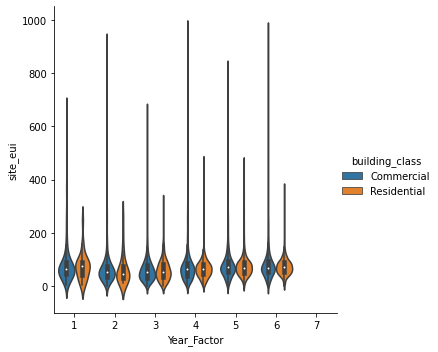

In [13]:
sns.catplot(x="Year_Factor", y="site_eui", hue="building_class", kind="violin", data=df)

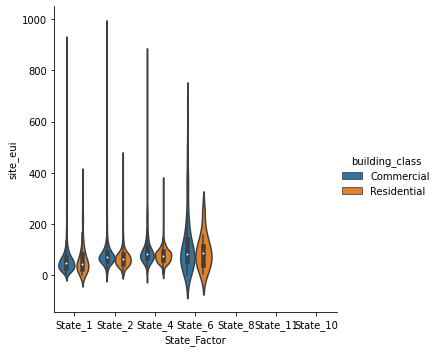

In [14]:
sns.catplot(x="State_Factor", y="site_eui", hue="building_class", kind="violin", data=df)

In [15]:
df_train_df=df[df["source"]=="train"]
df_less_site_eui=df_train_df[(df_train_df["site_eui"] < 300)]
df_more_site_eui=df_train_df[(df_train_df["site_eui"] >= 300)]
df_bw_0_and_100=df_train_df[(df_train_df["site_eui"] <=100)]
df_bw_100_and_200=df_train_df[(df_train_df["site_eui"] > 101) & (df_train_df["site_eui"] <= 200)]
df_bw_200_and_300=df_train_df[(df_train_df["site_eui"] > 201) & (df_train_df["site_eui"] <= 300)]
print(df_train_df.shape,df_less_site_eui.shape)

(14919, 65) (14720, 65)


In [16]:
df_more_site_eui=df_train_df[(df_train_df["site_eui"] >= 300)]
df_more_site_eui.facility_type.value_counts()

Laboratory                              33
Grocery_store_or_food_market            33
Office_Uncategorized                    23
Health_Care_Inpatient                   17
Education_College_or_university         12
Commercial_Other                        11
Food_Service_Restaurant_or_cafeteria    11
Industrial                               8
Data_Center                              7
Mixed_Use_Predominantly_Commercial       7
Commercial_Unknown                       5
Retail_Uncategorized                     5
Public_Assembly_Recreation               4
Mixed_Use_Commercial_and_Residential     4
Education_Uncategorized                  3
Education_Other_classroom                3
Nursing_Home                             3
Retail_Strip_shopping_mall               3
Parking_Garage                           2
Public_Assembly_Library                  2
Multifamily_Uncategorized                1
Office_Medical_non_diagnostic            1
Name: facility_type, dtype: int64

In [17]:
df_bw_0_and_100.facility_type.value_counts()

Office_Uncategorized                         4398
Multifamily_Uncategorized                    2916
Education_Other_classroom                    1088
Education_Uncategorized                       631
Lodging_Hotel                                 585
Retail_Uncategorized                          349
Education_College_or_university               275
Warehouse_Nonrefrigerated                     214
Mixed_Use_Predominantly_Commercial            211
Commercial_Other                              190
Lodging_Dormitory_or_fraternity_sorority      135
Religious_worship                             133
Office_Medical_non_diagnostic                 102
Warehouse_Distribution_or_Shipping_center      86
Office_Bank_or_other_financial                 76
Nursing_Home                                   57
Commercial_Unknown                             56
Industrial                                     55
Retail_Strip_shopping_mall                     53
Mixed_Use_Commercial_and_Residential           51


/usr/local/lib/python3.7/dist-packages/seaborn/axisgrid.py:409: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=figsize)
/usr/local/lib/python3.7/dist-packages/seaborn/axisgrid.py:409: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=figsize)
/usr/local/lib/python3.7/dist-packages/seaborn/axisgrid.py:409: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory.

<Figure size 3600x3600 with 0 Axes>

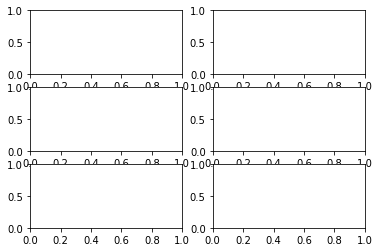

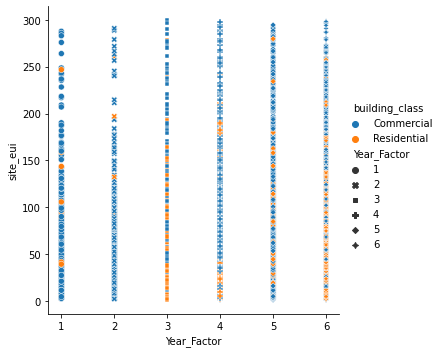

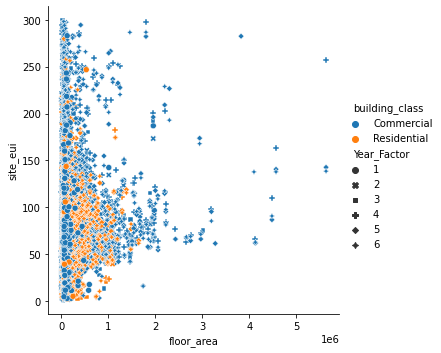

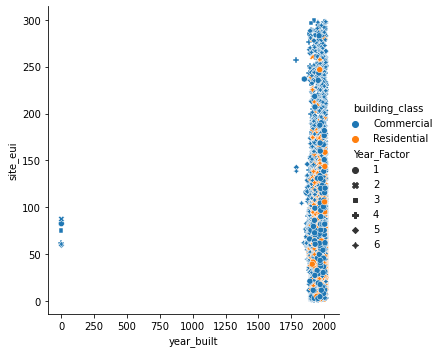

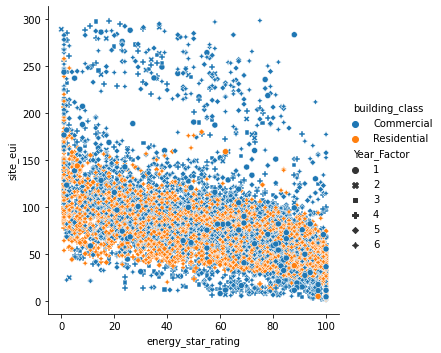

...

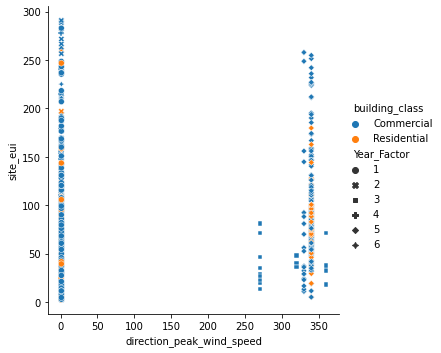

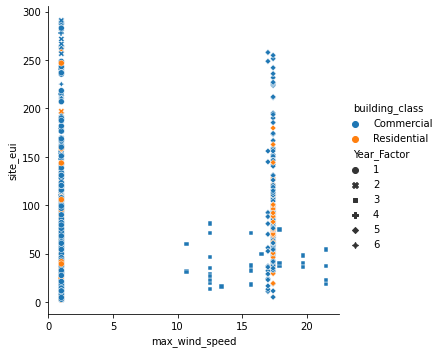

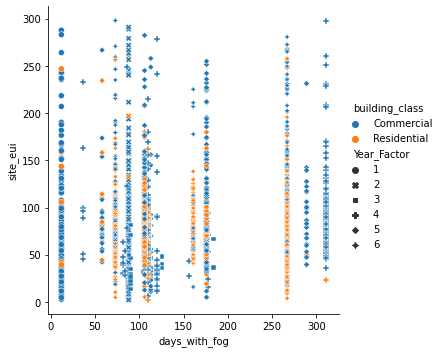

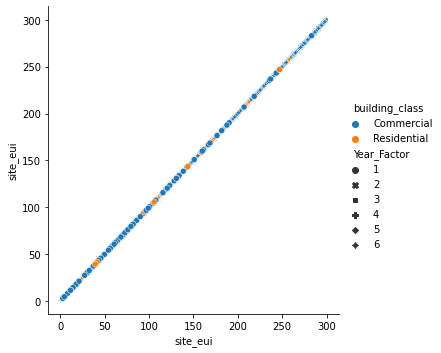

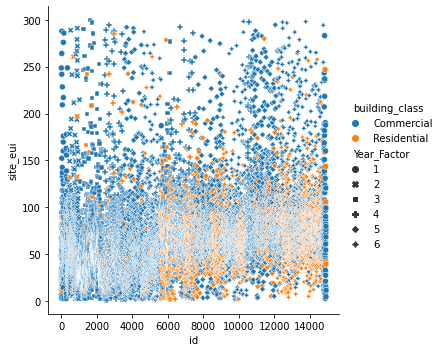

In [ ]:
plt.figure(figsize=(50,50))
df_column_numeric = df.select_dtypes(include=np.number).columns
key_col=df_column_numeric
for i in key_col:
  sns.relplot(x=i, y="site_eui", hue="building_class", style="Year_Factor", data=df_less_site_eui);

/usr/local/lib/python3.7/dist-packages/seaborn/axisgrid.py:409: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=figsize)
/usr/local/lib/python3.7/dist-packages/seaborn/axisgrid.py:409: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=figsize)
/usr/local/lib/python3.7/dist-packages/seaborn/axisgrid.py:409: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory.

<Figure size 3600x3600 with 0 Axes>

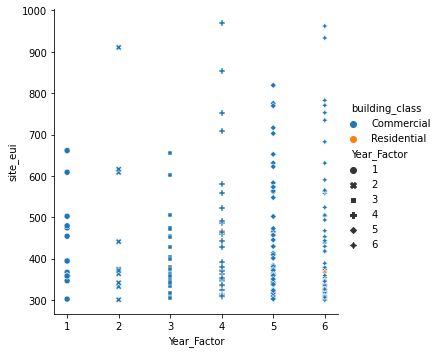

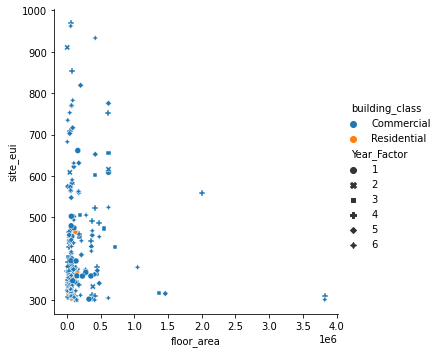

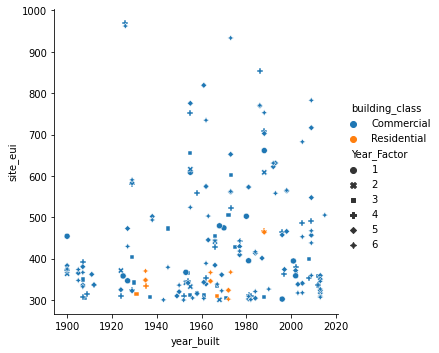

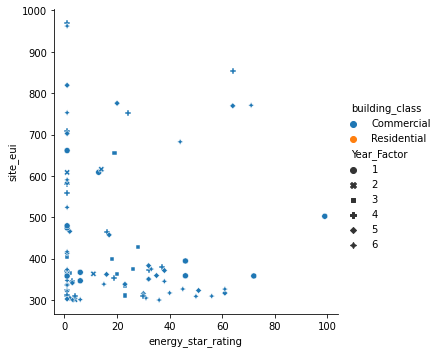

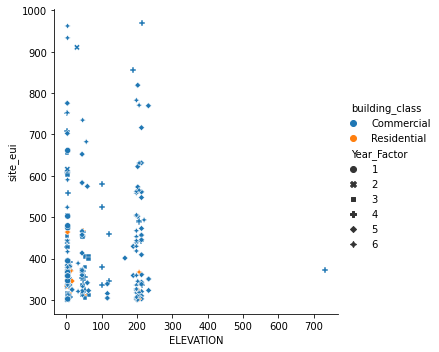

...

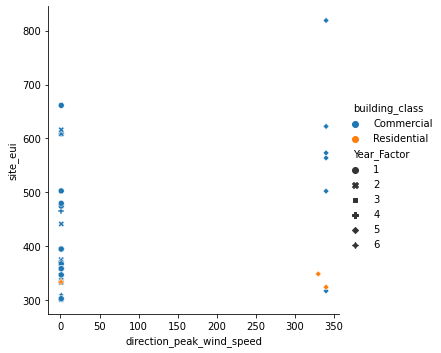

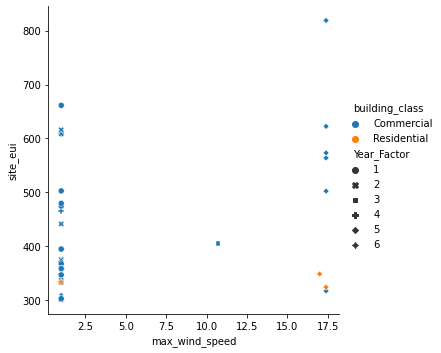

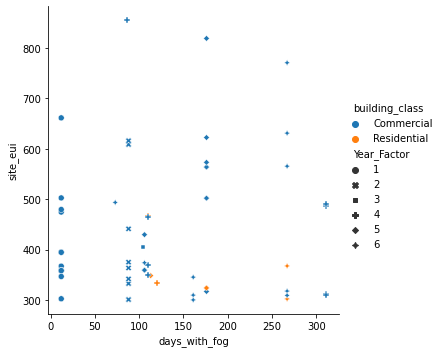

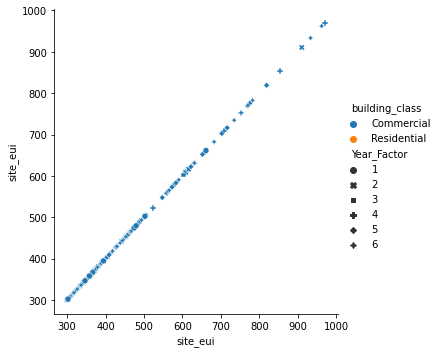

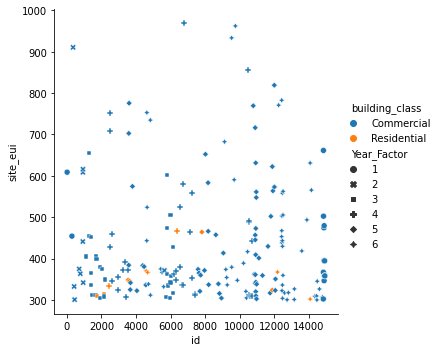

In [ ]:
plt.figure(figsize=(50,50))
df_column_numeric = df.select_dtypes(include=np.number).columns
key_col=df_column_numeric
for i in key_col:
  sns.relplot(x=i, y="site_eui", hue="building_class", style="Year_Factor", data=df_more_site_eui)

/usr/local/lib/python3.7/dist-packages/seaborn/axisgrid.py:409: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=figsize)
/usr/local/lib/python3.7/dist-packages/seaborn/axisgrid.py:409: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=figsize)
/usr/local/lib/python3.7/dist-packages/seaborn/axisgrid.py:409: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory.

<Figure size 3600x3600 with 0 Axes>

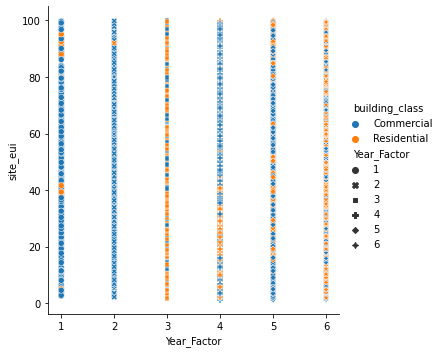

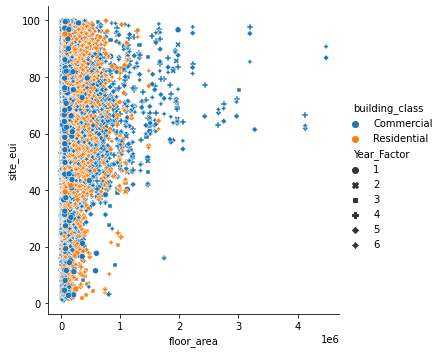

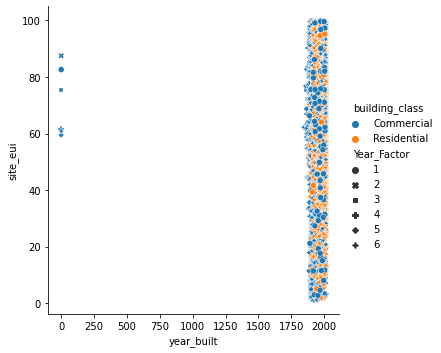

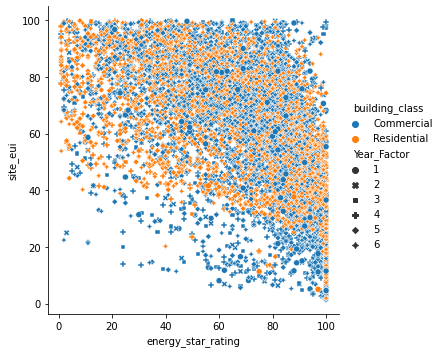

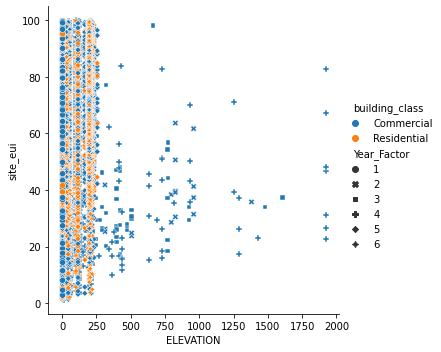

...

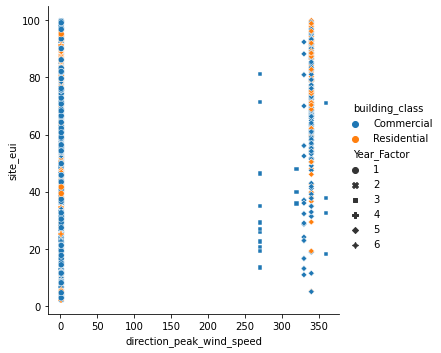

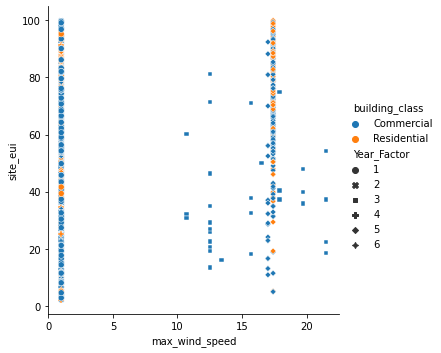

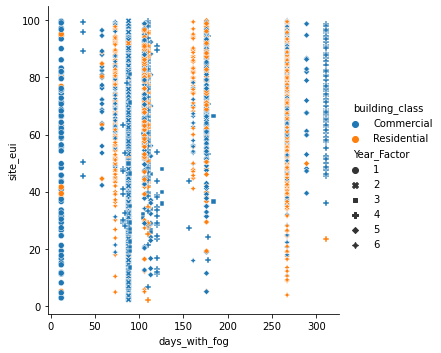

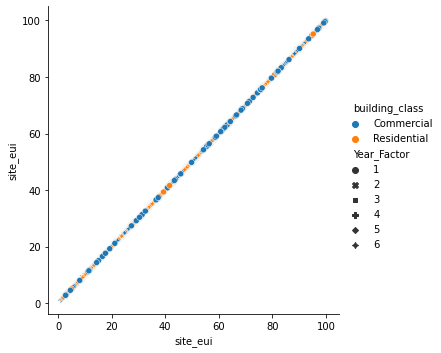

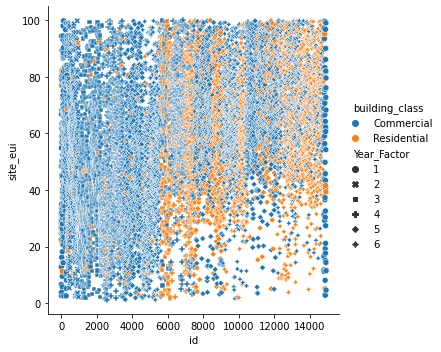

In [ ]:

plt.figure(figsize=(50,50))
df_column_numeric = df.select_dtypes(include=np.number).columns
key_col=df_column_numeric
for i in key_col:
  sns.relplot(x=i, y="site_eui", hue="building_class", style="Year_Factor", data=df_bw_0_and_100)

/usr/local/lib/python3.7/dist-packages/seaborn/axisgrid.py:409: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=figsize)
/usr/local/lib/python3.7/dist-packages/seaborn/axisgrid.py:409: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=figsize)
/usr/local/lib/python3.7/dist-packages/seaborn/axisgrid.py:409: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory.

<Figure size 3600x3600 with 0 Axes>

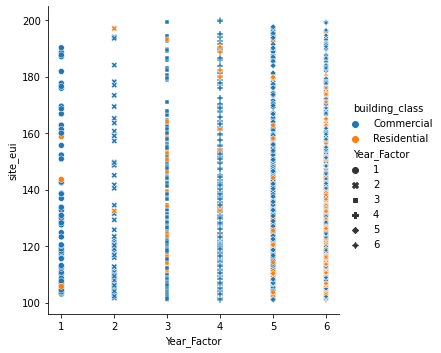

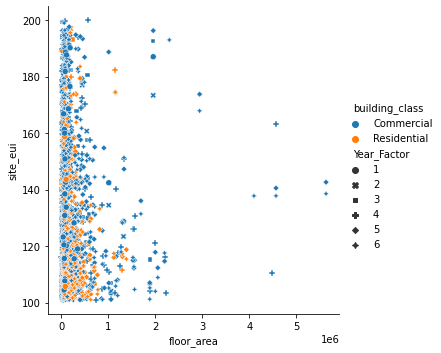

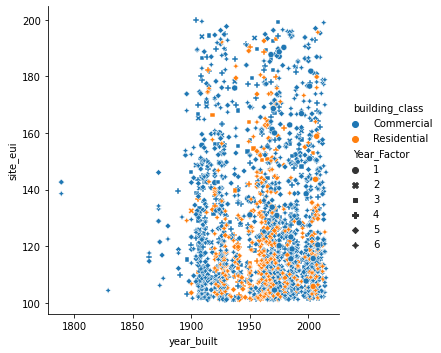

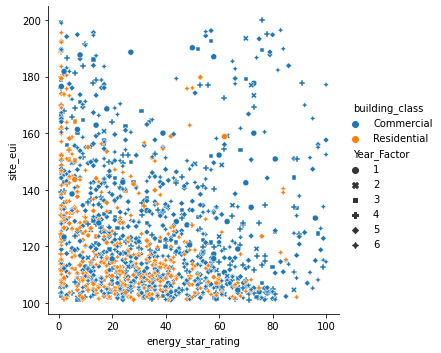

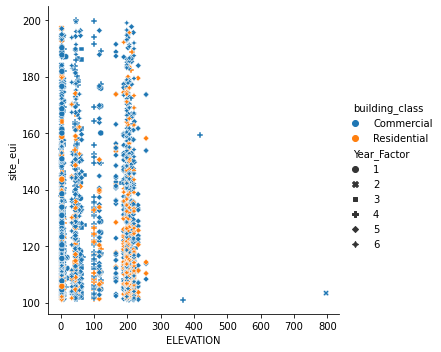

...

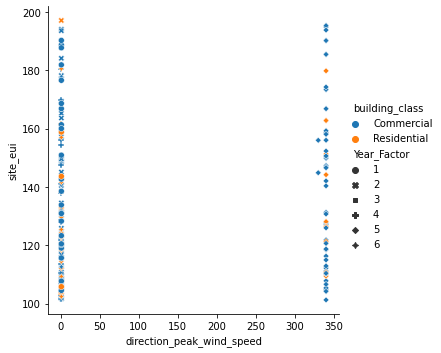

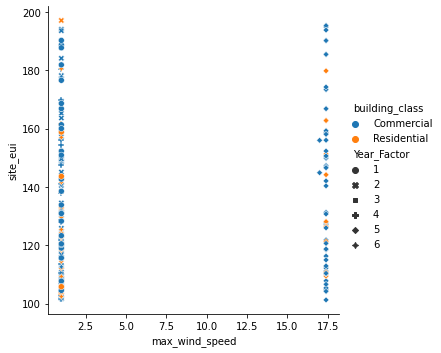

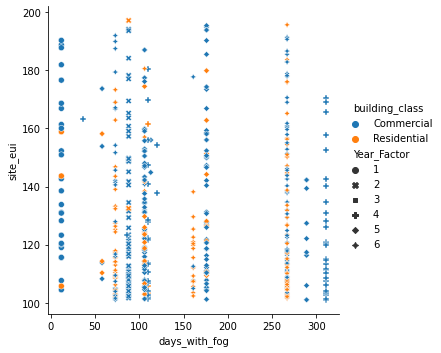

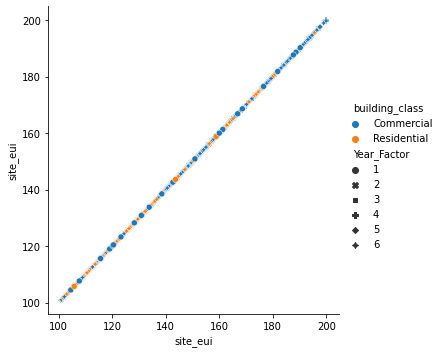

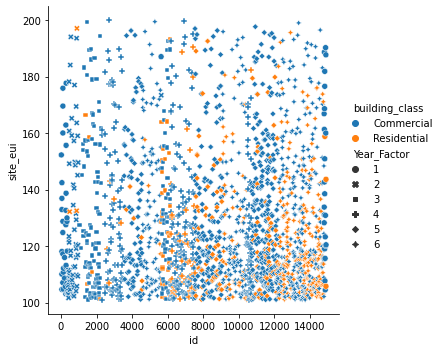

In [ ]:

plt.figure(figsize=(50,50))
df_column_numeric = df.select_dtypes(include=np.number).columns
key_col=df_column_numeric
for i in key_col:
  sns.relplot(x=i, y="site_eui", hue="building_class", style="Year_Factor", data=df_bw_100_and_200)

/usr/local/lib/python3.7/dist-packages/seaborn/axisgrid.py:409: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=figsize)
/usr/local/lib/python3.7/dist-packages/seaborn/axisgrid.py:409: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=figsize)
/usr/local/lib/python3.7/dist-packages/seaborn/axisgrid.py:409: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory.

<Figure size 3600x3600 with 0 Axes>

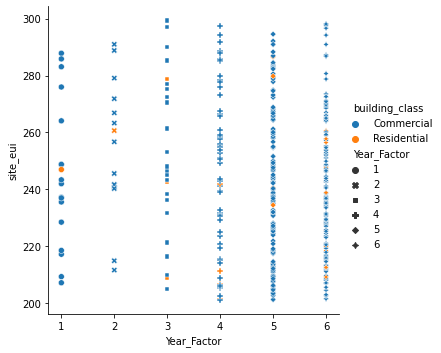

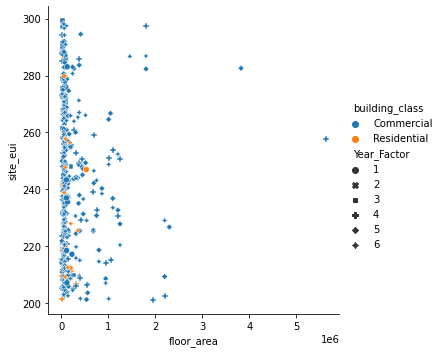

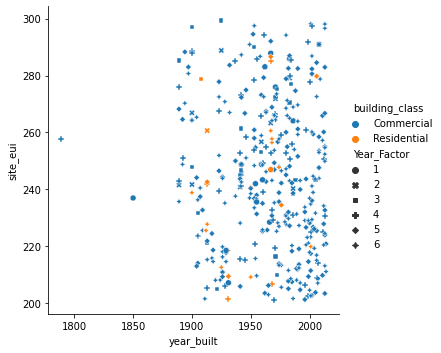

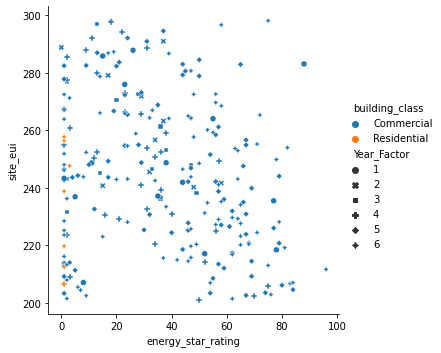

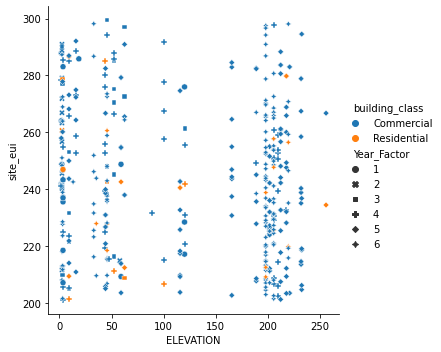

...

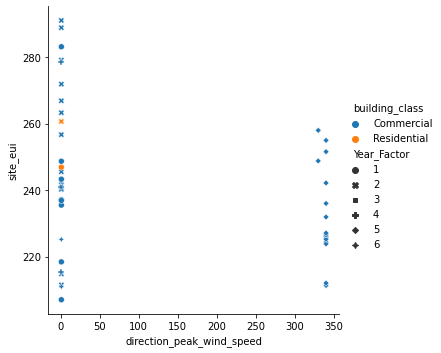

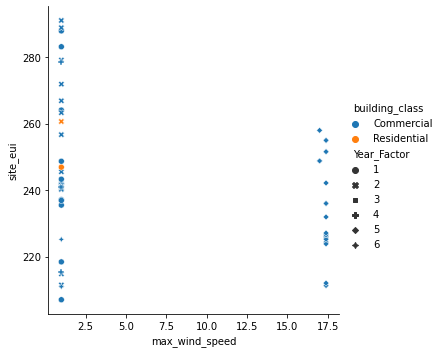

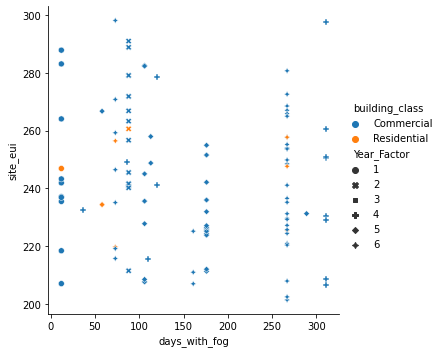

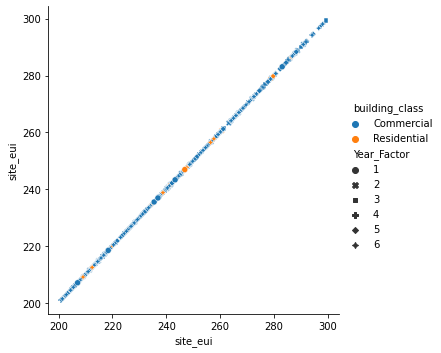

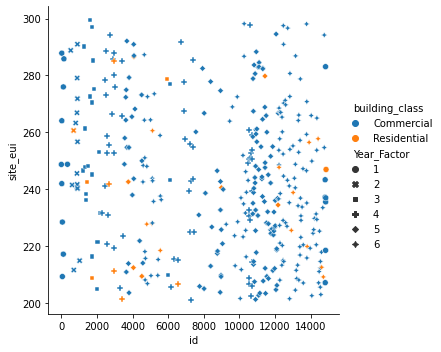

In [ ]:

plt.figure(figsize=(50,50))
df_column_numeric = df.select_dtypes(include=np.number).columns
key_col=df_column_numeric
for i in key_col:
  sns.relplot(x=i, y="site_eui", hue="building_class", style="Year_Factor", data=df_bw_200_and_300)

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7fa41fafc3d0>]],
      dtype=object)

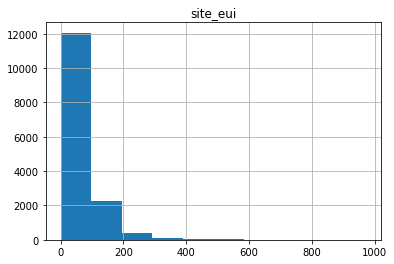

In [ ]:
df.hist(column=['site_eui'])

In [18]:
# Identify discrete and continous columns
col_disc=[]
col_medium=[]
col_cont=[]
print("Attributes with their distinct count and their classification")
for i in df.columns:
    if df[i].nunique() <=10:
        print(i,"==",df[i].nunique(),"== disc")
        col_disc.append(i)
    elif (df[i].nunique() >10 and df[i].nunique() <100):
        col_medium.append(i)    
        print(i,"==",df[i].nunique(),"== medium")
    else:
        col_cont.append(i)
        print(i,"==",df[i].nunique(),"== cont")

Attributes with their distinct count and their classification
Year_Factor == 7 == disc
State_Factor == 7 == disc
building_class == 2 == disc
facility_type == 60 == medium
floor_area == 9935 == cont
year_built == 166 == cont
energy_star_rating == 101 == cont
ELEVATION == 200 == cont
january_min_temp == 54 == medium
january_avg_temp == 143 == cont
january_max_temp == 47 == medium
february_min_temp == 46 == medium
february_avg_temp == 147 == cont
february_max_temp == 38 == medium
march_min_temp == 46 == medium
march_avg_temp == 143 == cont
march_max_temp == 40 == medium
april_min_temp == 34 == medium
april_avg_temp == 142 == cont
april_max_temp == 34 == medium
may_min_temp == 34 == medium
may_avg_temp == 144 == cont
may_max_temp == 36 == medium
june_min_temp == 36 == medium
june_avg_temp == 141 == cont
june_max_temp == 41 == medium
july_min_temp == 31 == medium
july_avg_temp == 140 == cont
july_max_temp == 40 == medium
august_min_temp == 30 == medium
august_avg_temp == 145 == cont
august_

In [19]:
col_na_lst=missing_value_df.loc[missing_value_df["percent_missing"] >0,"column_name"].values
#Removing site_eui and id value
col_na_lst=col_na_lst[:-2]
col_na_lst

array(['year_built', 'energy_star_rating', 'snowdepth_inches', 'avg_temp',
       'days_below_30F', 'days_below_20F', 'days_below_10F',
       'days_below_0F', 'days_above_80F', 'days_above_90F',
       'days_above_100F', 'days_above_110F', 'direction_max_wind_speed',
       'direction_peak_wind_speed', 'max_wind_speed', 'days_with_fog'],
      dtype=object)

In [20]:
for i in col_na_lst:
    if i in col_disc:
        print(i,"Discrete")
        df[i].fillna((df[i].mode()[0]), inplace=True)
    else:
        print(i,"Continuous")
        df[i].fillna((df[i].median()), inplace=True)

year_built Continuous
energy_star_rating Continuous
snowdepth_inches Continuous
avg_temp Continuous
days_below_30F Continuous
days_below_20F Continuous
days_below_10F Continuous
days_below_0F Continuous
days_above_80F Continuous
days_above_90F Continuous
days_above_100F Continuous
days_above_110F Discrete
direction_max_wind_speed Discrete
direction_peak_wind_speed Discrete
max_wind_speed Continuous
days_with_fog Continuous


In [21]:
df.columns[df.isna().any()].tolist()
df[df.id.isna()==True]

,Year_Factor,State_Factor,building_class,facility_type,floor_area,year_built,energy_star_rating,ELEVATION,january_min_temp,january_avg_temp,january_max_temp,february_min_temp,february_avg_temp,february_max_temp,march_min_temp,march_avg_temp,march_max_temp,april_min_temp,april_avg_temp,april_max_temp,may_min_temp,may_avg_temp,may_max_temp,june_min_temp,june_avg_temp,june_max_temp,july_min_temp,july_avg_temp,july_max_temp,august_min_temp,august_avg_temp,august_max_temp,september_min_temp,september_avg_temp,september_max_temp,october_min_temp,october_avg_temp,october_max_temp,november_min_temp,november_avg_temp,november_max_temp,december_min_temp,december_avg_temp,december_max_temp,cooling_degree_days,heating_degree_days,precipitation_inches,snowfall_inches,snowdepth_inches,avg_temp,days_below_30F,days_below_20F,days_below_10F,days_below_0F,days_above_80F,days_above_90F,days_above_100F,days_above_110F,direction_max_wind_speed,direction_peak_wind_speed,max_wind_speed,days_with_fog,site_eui,id,source
14918,1,State_6,Commercial,Commercial_Other,93500.0,1910.0,72.0,3.4,6,29.677419,53,15,36.035714,67,20,42.322581,77,35,54.3,83,46,64.483871,89,56,72.316667,95,63,80.241935,104,59,75.274194,94,51,70.033333,86,33,57.096774,84,36,51.883333,70,22,43.306452,62,1331,4335,72.81,44.0,12.0,54.651685,69.0,24.0,0.0,0.0,79.0,12.0,0.0,0.0,1.0,1.0,14.8,123.0,NaN,NaN,train


In [22]:
df.dropna(subset=['id'],inplace=True)

In [23]:
df.corr()['site_eui'].sort_values(ascending=False)

site_eui               1.000000
heating_degree_days    0.215823
days_below_20F         0.208428
snowfall_inches        0.200661
days_below_30F         0.198693
                         ...   
january_min_temp      -0.208517
january_avg_temp      -0.208781
avg_temp              -0.212124
april_avg_temp        -0.213956
energy_star_rating    -0.370752
Name: site_eui, Length: 61, dtype: float64

In [24]:
train_series=df.cov()["site_eui"]
#print((train_series))
low_cov=list(set(train_series[abs(train_series)>0.5].index))
#low_cov.append("site_eui")
print(len(low_cov))
print(type(low_cov))
low_cov.count("site_eui")


60
<class 'list'>


1

In [38]:
num = list(df.select_dtypes(include=[np.number]).columns)
non_num = list(df.select_dtypes(exclude=[np.number]).columns)

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function 

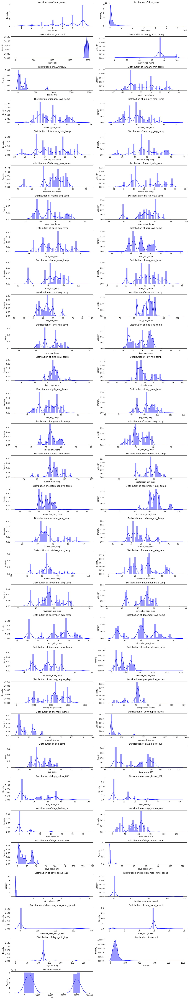

In [39]:
# Check distribution (num)
plt.figure(figsize=(15, 80))
for i, col in enumerate(num):
    # Plot distribution 
    plt.subplot(32,2,i+1); sns.distplot(df[col], color='blue')
    plt.title(f'Distribution of {col}')
# Show the plot
plt.tight_layout()
plt.show()

From the distribution plots above, we observed the following:


30% of the buildings are built in the 1920s
Nearly 30% of the houses in the dataset are built in the 1920s i.e. >80-year-old. This coincides with the historic housing boom after World War II. Such old buildings, if not upgraded, are likely to be less energy savvy. Thus, we will study further if there's any relationship between the age of the house and the EUI.

Most of the buildings reside in subtropical climate - Temperatures are mostly low with short summers
The average temperatures are concentrated around the lower spectrum of 50F-60F. In addition, there are hardly days above 100F, the hotter days are above 90F but typically do not last for >25 days. On the other hand, the colder months are typically between 20-30F. Thus. it is likely that the data are mostly collected from buildings in the sub-tropical climate. (NWS, 2022)

Huge proportion of houses with no energy star rating
Many buildings (approx. 30%) do not have energy star rating. Such building might not meet the minimum standards to be granted a rating, thus, we will delve deeper into these building to determine if EUI are higher in these building.

Huge proportion of houses with no wind & fog data
Most of the buildings do not have wind & fog data. (>50%). Thus, in order not to skew the dataset, we will replace the missing values with the average wind/ fog value.

Most numerical features in the dataset are highly skewed
This can pose a problem when modelling as most machine learning models require features to be normally distributed. Hence, we will keep this observation in mind and possibly look at techniques such as applying log to these numerical data before using them as features for the models.

c. Relationship between numerical features (all)

In [43]:
def plt_corr(df, figsize ):
    # Create the correlation matrix
    corr = df.corr()

    # Generate a mask for the upper triangle 
    mask = np.triu(np.ones_like(corr, dtype=bool))


    # Add the mask to the heatmap
    plt.figure(figsize=(figsize))
    sns.set(font_scale=1)
    sns.heatmap(corr, mask=mask, cmap=cmap, center=0, linewidths=1, fmt=".2f")

    plt.title('Correlation between numerical features')
    plt.show()

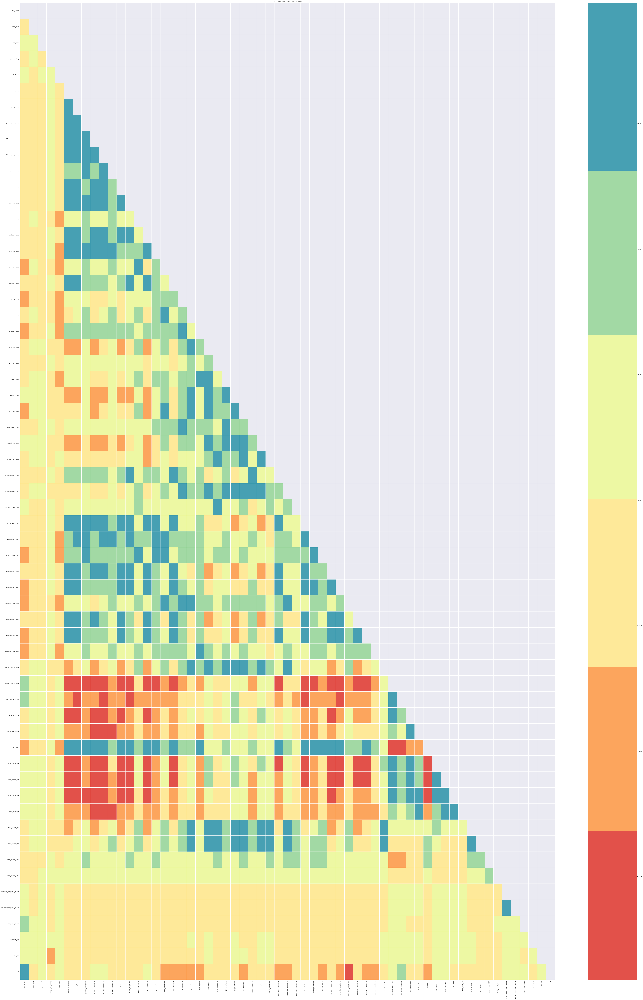

In [44]:
figsize=(100,150)
plt_corr(df[num], figsize)

As expected, the temperature related features are highly correlated. e.g. average temperature and days below/ above a given temperature.

Due to the large number of features (>60), we will next do more detailed analysis on the smaller subsets of these features to gain better insights.

d. Relationship between numerical features (non-temperature related features)
From the previous section, we see the temperature related features are highly correlated as expected.
In this section, we focus on the non-temperature related features to gain better insights.

In [47]:
num_nontemp = ['Year_Factor',
 'floor_area',
 'year_built',
 'energy_star_rating',
 'ELEVATION',
 'cooling_degree_days',
 'heating_degree_days',
 'precipitation_inches',
 'snowfall_inches',
 'snowdepth_inches',
 'avg_temp',
 'days_below_30F',
 'days_below_20F',
 'days_below_10F',
 'days_below_0F',
 'days_above_80F',
 'days_above_90F',
 'days_above_100F',
 'days_above_110F',
 'direction_max_wind_speed',
 'direction_peak_wind_speed',
 'max_wind_speed',
 'days_with_fog',
 'site_eui']

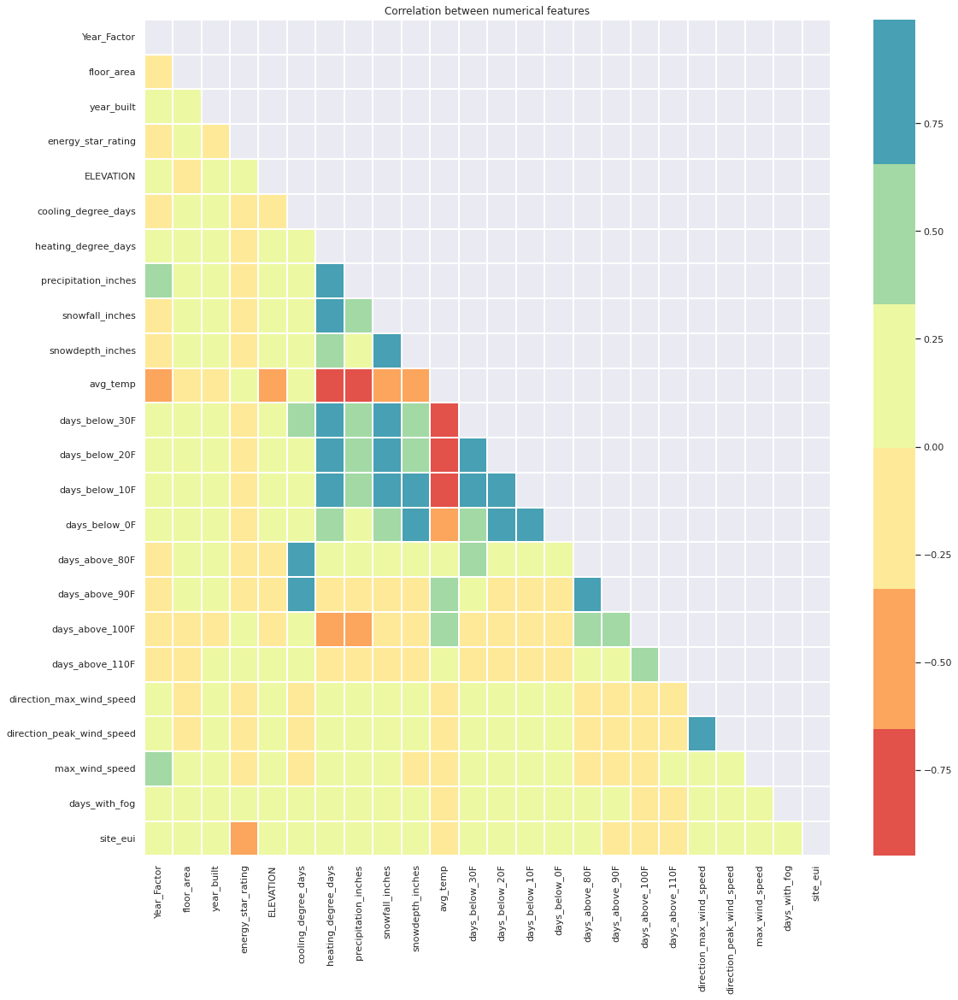

In [48]:
figsize=(18,18)
plt_corr(df[num_nontemp], figsize)

From the correlation heatmap above, we see that:

Lower EUI on buildings with more hotter days, but higher EUI for building with more cooler days
Since temperature >=90F are summer temperatures, thus, it makes sense that the more summer days there are, the lower the energy consumed since no building heating is required. On the other hand, for temperatures <=80F, the more the number of days of such colder days, the higher the energy consumed possibly for heating the building. This aligns with our research which shows that generally, households spend >50% of the energy consumption on space & water heating and <10% on air conditioning (EIA, 2015). This also aligns with our previous findings that most of the buildings reside in sub-tropical climates, thus, it is likely that less air conditioning and thus lower EUI are needed even during summer.

Lower EUI on buildings with higher energy star rating
When the building has high energy star rating, the energy consumed is lower. This is expected since buildings with high energy star ratings likely have more eco-friendly installations (e.g. energy saving heating), thus, lower energy consumed.

Older buildings have lower EUI, higher energy star ratings
This goes against our intuition that older buildings might not be equipped with energy saving facilities, consuming more energy. This might be likely because such old buildings have been actively upgraded with better energy savvy features as seen in the positive correlation with the energy star ratings.

Buildings with larger floor area have higher EUI
Buildings with larger floor area have higher EUI (energy per square foot per year, Energy star, 2021). This is likely because reduced surface area results in lesser heat loss/ gain, thus requiring lesser energy for heating, cooling, and illumination (Izzet, 2016).

2.2 Categorial data

In [50]:
# Categorial features 
df[non_num].describe()

,State_Factor,building_class,facility_type,source
count,24623,24623,24623,24623
unique,7,2,60,2
top,State_4,Commercial,Office_Uncategorized,train
freq,6868,16777,6785,14918


In [51]:
def plt_matrix(df, figsize):
    # Create the correlation matrix
    #corr = df.corr()

    # Generate a mask for the upper triangle 
    #mask = np.triu(np.ones_like(corr, dtype=bool))


    # Add the mask to the heatmap
    plt.figure(figsize=(figsize))
    sns.pairplot(df)

    plt.title('Scatter plot matrix')
    plt.show()

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning
/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning
/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning
/usr/local/lib/python3.7/dist-packages/seaborn

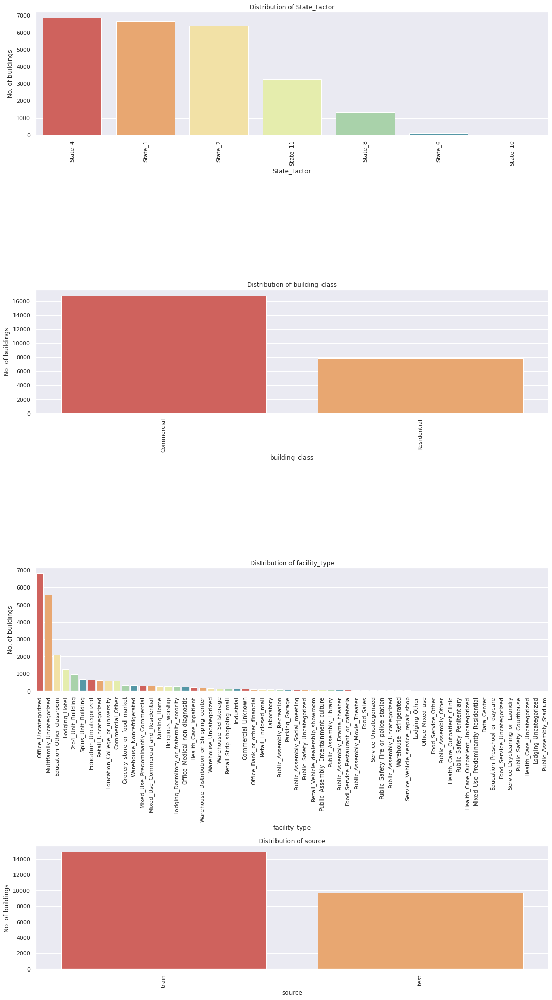

In [55]:
# Check distribution (non-num)
plt.figure(figsize=(15, 27))
# Plot distribution 
for i, col in enumerate(non_num):    
    if col == 'day' or col == 'month':
        order = None
    else: 
        order = df[col].value_counts().index   
    plt.subplot(4,1,i+1); sns.countplot(df[col],palette=cmap, order = order ) 
    plt.title(f'Distribution of {col}')
    plt.ylabel('No. of buildings')
    plt.xticks(rotation=90)
# Show the plot
plt.tight_layout()
plt.show()

According to our research (US department of energy, 2008), residential buildings generally consume more energy than commercial buildings. Thus, we will keep this observation in mind when studying the relationship against the target variable.

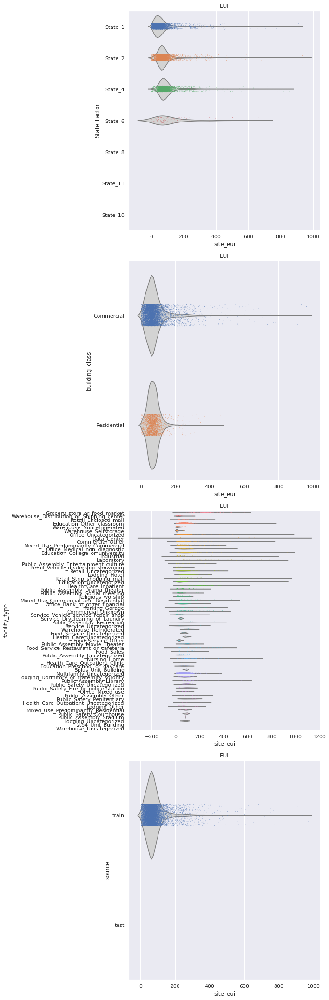

In [57]:
# Check distribution (num)
plt.figure(figsize=(10, 30))
for i, col in enumerate(non_num):
    # Plot distribution    
    plt.subplot(4,1,1+i); sns.violinplot(x='site_eui', y=col, data=df, inner=None, color='lightgray');sns.stripplot(x='site_eui', y=col, data=df, size=0.8,jitter=True);
    plt.title(f'EUI');
    plt.ylabel(f'{col}')    
# Show the plot
plt.tight_layout()
plt.show()

In [59]:
avg_comm_eui = round(df[df['building_class']=='Commercial']['site_eui'].mean(),2)
print(f'Commercial building has average EUI at {avg_comm_eui}')

Commercial building has average EUI at 79.16


In [60]:
avg_resid_eui = round(df[df['building_class']=='Residential']['site_eui'].mean(),2)
print(f'Residential building has average EUI at {avg_resid_eui}')

Residential building has average EUI at 71.86


Overall, we observed the following from the categorial features:

Commercial building have higher EUI compared to Residential buildings
Contrary to our literature research, commercial buildings have higher average EUI compared to residential building . We will keep this in view and investigate the trend further in the next section.

Large spread & more outlier EUI for commercial buildings
Also, we see from the plot that there is a larger spread of commercial buildings at the higher end of EUI (>200). These outliers are likely due to the facilities which operate intensively 24/7 e.g. Data centres, health care etc. We will attempt to confirm this observation in the next section.

2.3 Target variable

In [61]:
# Calc conversion rate per group
def calc_EUI(dataframe, column_names=None):
    #print('test')
    if column_names != None:
        # Calc mean EUI
        #print('test')
        mean_EUI = dataframe.groupby(column_names)['site_eui'].mean()  
        #print(mean_EUI)
        # Fill missing values with 0
        mean_EUI = mean_EUI.fillna(0) 
    else:       
        # Conversion rate 
        mean_EUI = dataframe['site_eui'].mean()  

    return round(mean_EUI,2)

In [63]:
original_EUI = calc_EUI(df)
print(f'The average EUI for the full dataset is : {original_EUI}')

The average EUI for the full dataset is : 77.32


a. Target variable vs numeric features
In this section, we try to understand if there is any trend between the numeric feature vs EUI.

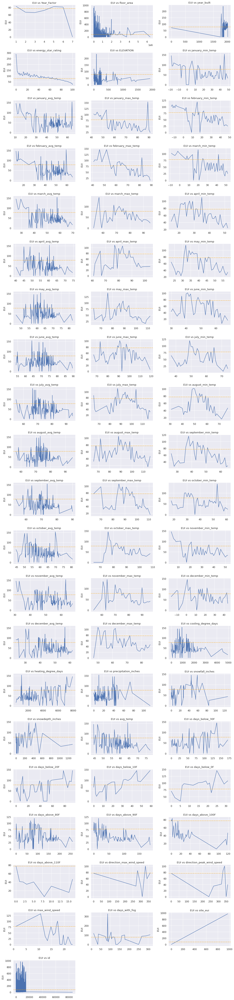

In [65]:
# Check distribution (num)
plt.figure(figsize=(15, 66), dpi=80)

for i, col in enumerate(num):
    # Calc conv rate 
    eui = calc_EUI(df, [col])
    #print(eui)
    plt.subplot(22,3,i+1);plt.plot(eui.index, eui);plt.ylabel('EUI') 
    plt.title(f'EUI vs {col}')
    # plot the mean 
    plt.axhline(y=original_EUI, color='orange', linestyle='--', alpha=0.7)
# Show the plot
plt.tight_layout()
plt.show() 

From above, we see that:

EUI drops significantly when energy star rating <50
This is expected since buildings with energy star ratings theoretically have more energy efficient features.

EUI drops when year factor >5
It's likely that the energy consciousness of the public had increased significantly over the years. Thus, buildings surveyed in more recent years are likely to be more energy efficient.

EUI decrease with cooling degree days but increases with heating degree days
There is a step drop in EUI when cooling degree days >2000 and a step increase in EUI when heating degree days is >4000. Thus, it's likely that prolonged cold weather caused even higher energy consumption. This aligns with our previous observation that higher temperature generally results in lower EUI while lower temperature results in higher EUI.

EUI drop significantly when snow depth <700 inches and snowfall >70 inches
Interestingly, when snowfall increases, EUI drops significantly. Based on our research, this is likely due to the insulating property of snow which protects the area below snow from changes in atmospheric temperature. (NSIDC, 2020)
Nevertheless, we also note that at extremely high snow fall, EUI starts trending upwards again.

Also, aligned with previous observations, EUI increase sharply when floor area increases.
On the other hand, there seem to be a rather flat and sometimes noisy relationship between building age and EUI. It is likely that the older buildings in the dataset might have undergone upgrading to be more energy efficient. Thus, our hypothesis that older building consumes more EUI might not be valid after all

b. Target variable vs categorial features¶
In this section, we try to understand if there is any trend between the categorial feature vs EUI.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations
  if sys.path[0] == '':


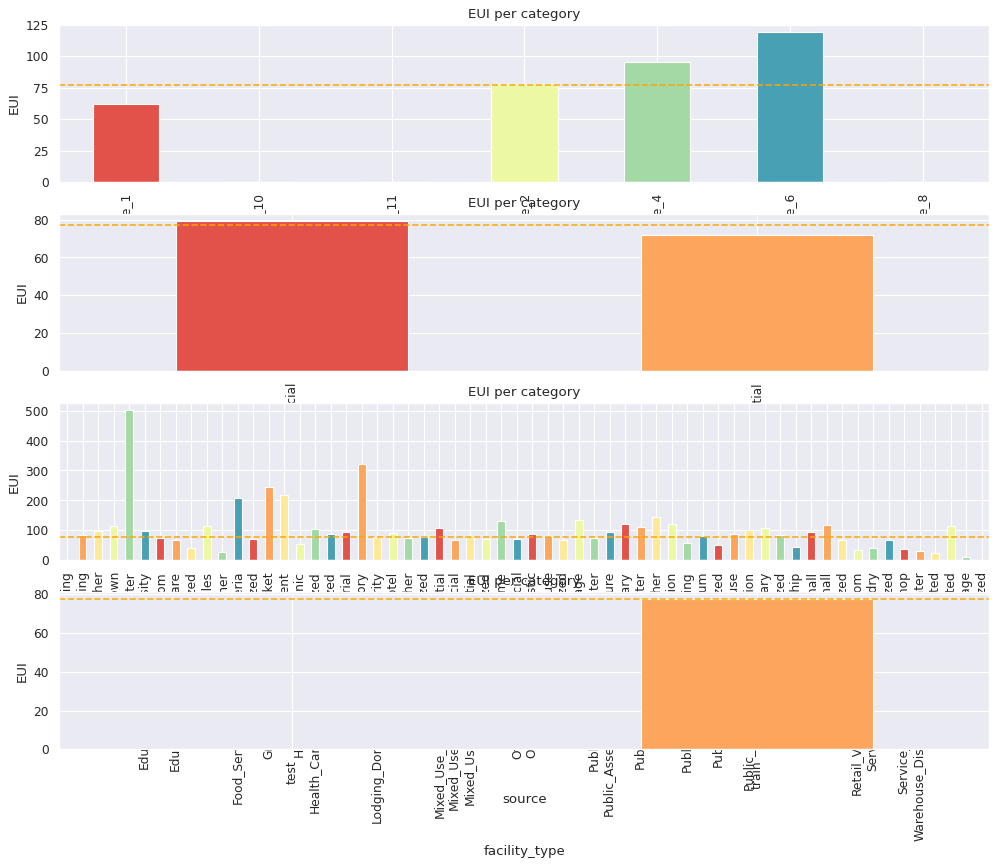

In [67]:
# Check distribution (non-num)
plt.figure(figsize=(15, 12), dpi=80)
for i, col in enumerate(non_num):   
    # Calc conv rate 
    eui = calc_EUI(df, [col])   
    # Plot distribution 
    plt.subplot(4,1,i+1);eui.plot(kind='bar', color=cmap );plt.ylabel('EUI') 
    plt.title('EUI per category')
    # plot the mean 
    plt.axhline(y=original_EUI, color='orange', linestyle='--', alpha=0.9)
# Show the plot
plt.tight_layout()
plt.show()   

In [68]:
pd.DataFrame( df.groupby(['building_class'])['site_eui', 'energy_star_rating'].mean() )

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  """Entry point for launching an IPython kernel.


,site_eui,energy_star_rating
building_class,,
Commercial,79.155955,67.476188
Residential,71.857694,63.221642


We see again that the EUI is higher in commercial building than residential buildings.
Moreover, EUI is higher in data centres, laboratories, food services and groceries/ food markets. Aligned with our previous hypothesis, EUI are higher in these buildings since they are likely to operate 24/7. We will confirm this by creating a new feature - 'building_class_group' which group all commercial building most likely to operate 24/7 in 1 category 'commercial_24_7'. The other 2 categories will be 'commercial_other' & 'residential'. Our hypothesis is that building under 'commercial_24_7' will have high EUI.

In [70]:
df['building_class_group'] = df.apply(building_class_group, axis=1)
df.head()

,Year_Factor,State_Factor,building_class,facility_type,floor_area,year_built,energy_star_rating,ELEVATION,january_min_temp,january_avg_temp,january_max_temp,february_min_temp,february_avg_temp,february_max_temp,march_min_temp,march_avg_temp,march_max_temp,april_min_temp,april_avg_temp,april_max_temp,may_min_temp,may_avg_temp,may_max_temp,june_min_temp,june_avg_temp,june_max_temp,july_min_temp,july_avg_temp,july_max_temp,august_min_temp,august_avg_temp,august_max_temp,september_min_temp,september_avg_temp,september_max_temp,october_min_temp,october_avg_temp,october_max_temp,november_min_temp,november_avg_temp,november_max_temp,december_min_temp,december_avg_temp,december_max_temp,cooling_degree_days,heating_degree_days,precipitation_inches,snowfall_inches,snowdepth_inches,avg_temp,days_below_30F,days_below_20F,days_below_10F,days_below_0F,days_above_80F,days_above_90F,days_above_100F,days_above_110F,direction_max_wind_speed,direction_peak_wind_speed,max_wind_speed,days_with_fog,site_eui,id,source,building_class_group
0,1,State_1,Commercial,Grocery_store_or_food_market,61242.0,1942.0,11.0,2.4,36,50.5,68,35,50.589286,73,40,53.693548,80,41,55.5,78,46,56.854839,84,50,60.5,90,52,62.725806,84,52,62.16129,85,52,64.65,90,47,63.016129,83,43,53.8,72,36,49.274194,71,115,2960,16.59,0.0,0.0,56.972603,0.0,0.0,0.0,0.0,14.0,0.0,0.0,0.0,1.0,1.0,1.0,123.0,248.682615,0.0,train,Commercial_24_7
1,1,State_1,Commercial,Warehouse_Distribution_or_Shipping_center,274000.0,1955.0,45.0,1.8,36,50.5,68,35,50.589286,73,40,53.693548,80,41,55.5,78,46,56.854839,84,50,60.5,90,52,62.725806,84,52,62.16129,85,52,64.65,90,47,63.016129,83,43,53.8,72,36,49.274194,71,115,2960,16.59,0.0,0.0,56.972603,0.0,0.0,0.0,0.0,14.0,0.0,0.0,0.0,1.0,1.0,1.0,12.0,26.500150,1.0,train,Commercial_others
2,1,State_1,Commercial,Retail_Enclosed_mall,280025.0,1951.0,97.0,1.8,36,50.5,68,35,50.589286,73,40,53.693548,80,41,55.5,78,46,56.854839,84,50,60.5,90,52,62.725806,84,52,62.16129,85,52,64.65,90,47,63.016129,83,43,53.8,72,36,49.274194,71,115,2960,16.59,0.0,0.0,56.972603,0.0,0.0,0.0,0.0,14.0,0.0,0.0,0.0,1.0,1.0,1.0,12.0,24.693619,2.0,train,Commercial_others
3,1,State_1,Commercial,Education_Other_classroom,55325.0,1980.0,46.0,1.8,36,50.5,68,35,50.589286,73,40,53.693548,80,41,55.5,78,46,56.854839,84,50,60.5,90,52,62.725806,84,52,62.16129,85,52,64.65,90,47,63.016129,83,43,53.8,72,36,49.274194,71,115,2960,16.59,0.0,0.0,56.972603,0.0,0.0,0.0,0.0,14.0,0.0,0.0,0.0,1.0,1.0,1.0,12.0,48.406926,3.0,train,Commercial_others
4,1,State_1,Commercial,Warehouse_Nonrefrigerated,66000.0,1985.0,100.0,2.4,36,50.5,68,35,50.589286,73,40,53.693548,80,41,55.5,78,46,56.854839,84,50,60.5,90,52,62.725806,84,52,62.16129,85,52,64.65,90,47,63.016129,83,43,53.8,72,36,49.274194,71,115,2960,16.59,0.0,0.0,56.972603,0.0,0.0,0.0,0.0,14.0,0.0,0.0,0.0,1.0,1.0,1.0,123.0,3.899395,4.0,train,Commercial_others


In [72]:
# List all non-numeric attributes
non_num = list(df.select_dtypes(exclude=[np.number]).columns)
print(f'There are {len(non_num)} categorial columns in the dataset')
non_num

There are 5 categorial columns in the dataset


['State_Factor',
 'building_class',
 'facility_type',
 'source',
 'building_class_group']

In [69]:
def building_class_group(d):
    if (d['building_class'] == 'Residential'):
        return 'Residential'
    elif (d['facility_type'] in ('Data_Center', 'Laboratory', 'Grocery_store_or_food_market', 'Health_Care_Inpatient', 'Health_Care_Uncategorized', 'Health_Care_Outpatient_Uncategorized', 'Food_Service_Restaurant_or_cafeteria')):
        return 'Commercial_24_7'
    else:
        return 'Commercial_others'

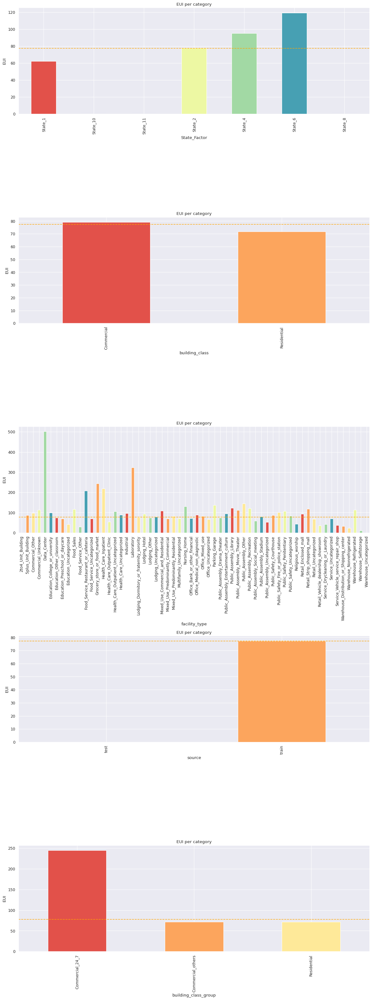

In [76]:
# Check distribution (non-num)
plt.figure(figsize=(15, 40), dpi=80)
for i, col in enumerate(non_num):   
    # Calc conv rate 
    eui = calc_EUI(df, [col])   
    # Plot distribution 
    plt.subplot(5,1,i+1);eui.plot(kind='bar', color=cmap );plt.ylabel('EUI') 
    plt.title('EUI per category')
    # plot the mean 
    plt.axhline(y=original_EUI, color='orange', linestyle='--', alpha=0.9)
# Show the plot
plt.tight_layout()
plt.show() 

As expected, the selected facility types buildings which operates 24/7 now has a significantly higher EUI compared to the residential buildings. On the other hand, the normal commercial buildings which likely operate only during weekdays & office hours consume similar EUI as the residential buildings.

In [74]:
pd.DataFrame( df.groupby(['building_class_group'])['site_eui', 'energy_star_rating'].mean() )
#mean_EUI = dataframe.groupby(column_names)['site_eui'].mean() 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  """Entry point for launching an IPython kernel.


,site_eui,energy_star_rating
building_class_group,,
Commercial_24_7,244.726512,58.249668
Commercial_others,71.867075,67.909760
Residential,71.857694,63.221642


In [25]:
df.head()

,Year_Factor,State_Factor,building_class,facility_type,floor_area,year_built,energy_star_rating,ELEVATION,january_min_temp,january_avg_temp,january_max_temp,february_min_temp,february_avg_temp,february_max_temp,march_min_temp,march_avg_temp,march_max_temp,april_min_temp,april_avg_temp,april_max_temp,may_min_temp,may_avg_temp,may_max_temp,june_min_temp,june_avg_temp,june_max_temp,july_min_temp,july_avg_temp,july_max_temp,august_min_temp,august_avg_temp,august_max_temp,september_min_temp,september_avg_temp,september_max_temp,october_min_temp,october_avg_temp,october_max_temp,november_min_temp,november_avg_temp,november_max_temp,december_min_temp,december_avg_temp,december_max_temp,cooling_degree_days,heating_degree_days,precipitation_inches,snowfall_inches,snowdepth_inches,avg_temp,days_below_30F,days_below_20F,days_below_10F,days_below_0F,days_above_80F,days_above_90F,days_above_100F,days_above_110F,direction_max_wind_speed,direction_peak_wind_speed,max_wind_speed,days_with_fog,site_eui,id,source
0,1,State_1,Commercial,Grocery_store_or_food_market,61242.0,1942.0,11.0,2.4,36,50.5,68,35,50.589286,73,40,53.693548,80,41,55.5,78,46,56.854839,84,50,60.5,90,52,62.725806,84,52,62.16129,85,52,64.65,90,47,63.016129,83,43,53.8,72,36,49.274194,71,115,2960,16.59,0.0,0.0,56.972603,0.0,0.0,0.0,0.0,14.0,0.0,0.0,0.0,1.0,1.0,1.0,123.0,248.682615,0.0,train
1,1,State_1,Commercial,Warehouse_Distribution_or_Shipping_center,274000.0,1955.0,45.0,1.8,36,50.5,68,35,50.589286,73,40,53.693548,80,41,55.5,78,46,56.854839,84,50,60.5,90,52,62.725806,84,52,62.16129,85,52,64.65,90,47,63.016129,83,43,53.8,72,36,49.274194,71,115,2960,16.59,0.0,0.0,56.972603,0.0,0.0,0.0,0.0,14.0,0.0,0.0,0.0,1.0,1.0,1.0,12.0,26.500150,1.0,train
2,1,State_1,Commercial,Retail_Enclosed_mall,280025.0,1951.0,97.0,1.8,36,50.5,68,35,50.589286,73,40,53.693548,80,41,55.5,78,46,56.854839,84,50,60.5,90,52,62.725806,84,52,62.16129,85,52,64.65,90,47,63.016129,83,43,53.8,72,36,49.274194,71,115,2960,16.59,0.0,0.0,56.972603,0.0,0.0,0.0,0.0,14.0,0.0,0.0,0.0,1.0,1.0,1.0,12.0,24.693619,2.0,train
3,1,State_1,Commercial,Education_Other_classroom,55325.0,1980.0,46.0,1.8,36,50.5,68,35,50.589286,73,40,53.693548,80,41,55.5,78,46,56.854839,84,50,60.5,90,52,62.725806,84,52,62.16129,85,52,64.65,90,47,63.016129,83,43,53.8,72,36,49.274194,71,115,2960,16.59,0.0,0.0,56.972603,0.0,0.0,0.0,0.0,14.0,0.0,0.0,0.0,1.0,1.0,1.0,12.0,48.406926,3.0,train
4,1,State_1,Commercial,Warehouse_Nonrefrigerated,66000.0,1985.0,100.0,2.4,36,50.5,68,35,50.589286,73,40,53.693548,80,41,55.5,78,46,56.854839,84,50,60.5,90,52,62.725806,84,52,62.16129,85,52,64.65,90,47,63.016129,83,43,53.8,72,36,49.274194,71,115,2960,16.59,0.0,0.0,56.972603,0.0,0.0,0.0,0.0,14.0,0.0,0.0,0.0,1.0,1.0,1.0,123.0,3.899395,4.0,train


In [30]:
df_column_numeric = df.select_dtypes(include=np.number).columns
df_column_category = df.select_dtypes(exclude=np.number).columns
df[df_column_category]

,State_Factor,building_class,facility_type,source
0,State_1,Commercial,Grocery_store_or_food_market,train
1,State_1,Commercial,Warehouse_Distribution_or_Shipping_center,train
2,State_1,Commercial,Retail_Enclosed_mall,train
3,State_1,Commercial,Education_Other_classroom,train
4,State_1,Commercial,Warehouse_Nonrefrigerated,train
...,...,...,...,...
9700,State_11,Residential,5plus_Unit_Building,test
9701,State_11,Residential,5plus_Unit_Building,test
9702,State_11,Residential,5plus_Unit_Building,test
9703,State_11,Residential,5plus_Unit_Building,test


In [33]:
df_label=df[df_column_category.drop(["source","facility_type","State_Factor"])]
df_label

,building_class
0,Commercial
1,Commercial
2,Commercial
3,Commercial
4,Commercial
...,...
9700,Residential
9701,Residential
9702,Residential
9703,Residential


In [34]:
from sklearn import preprocessing
le = preprocessing.LabelEncoder()
#df_label["facility_type"] = le.fit_transform(df_label["facility_type"])
df_label["building_class"] = le.fit_transform(df_label["building_class"])

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  after removing the cwd from sys.path.


In [35]:
df_category_onehot = pd.get_dummies(df[df_column_category.drop(["source","building_class","State_Factor"])])
df_category_onehot.columns

Index(['facility_type_2to4_Unit_Building', 'facility_type_5plus_Unit_Building',
       'facility_type_Commercial_Other', 'facility_type_Commercial_Unknown',
       'facility_type_Data_Center',
       'facility_type_Education_College_or_university',
       'facility_type_Education_Other_classroom',
       'facility_type_Education_Preschool_or_daycare',
       'facility_type_Education_Uncategorized', 'facility_type_Food_Sales',
       'facility_type_Food_Service_Other',
       'facility_type_Food_Service_Restaurant_or_cafeteria',
       'facility_type_Food_Service_Uncategorized',
       'facility_type_Grocery_store_or_food_market',
       'facility_type_Health_Care_Inpatient',
       'facility_type_Health_Care_Outpatient_Clinic',
       'facility_type_Health_Care_Outpatient_Uncategorized',
       'facility_type_Health_Care_Uncategorized', 'facility_type_Industrial',
       'facility_type_Laboratory',
       'facility_type_Lodging_Dormitory_or_fraternity_sorority',
       'facility_type_L

In [36]:
df_final = pd.concat([df_label,df_category_onehot,df[df_column_numeric],df["source"]],axis=1)
#df_final = pd.concat([df_label,df[df_column_numeric],df["source"]],axis=1)
df_final["source"]

0       train
1       train
2       train
3       train
4       train
        ...  
9700     test
9701     test
9702     test
9703     test
9704     test
Name: source, Length: 24623, dtype: object

In [37]:
df_final.isna().sum()


building_class                          0
facility_type_2to4_Unit_Building        0
facility_type_5plus_Unit_Building       0
facility_type_Commercial_Other          0
facility_type_Commercial_Unknown        0
                                     ... 
max_wind_speed                          0
days_with_fog                           0
site_eui                             9705
id                                      0
source                                  0
Length: 123, dtype: int64

In [ ]:
from scipy import stats
import numpy as np
z = np.abs(stats.zscore(df_temp))
print(z)

[[0.57925955        nan 0.01637695 ...        nan        nan        nan]
 [0.57925955        nan 0.01637695 ...        nan        nan        nan]
 [0.57925955        nan 0.01637695 ...        nan        nan        nan]
 ...
 [0.57925955        nan 0.01637695 ...        nan        nan        nan]
 [0.57925955        nan 0.01637695 ...        nan        nan        nan]
 [0.57925955        nan 0.01637695 ...        nan        nan        nan]]


/usr/local/lib/python3.7/dist-packages/scipy/stats/stats.py:2419: RuntimeWarning: invalid value encountered in true_divide
  return (a - mns) / sstd


In [ ]:
threshold = 3
print(np.where(z > 3))

(array([    0,     0,     1, ..., 14916, 14916, 14917]), array([ 14, 118,  56, ...,  57, 118, 118]))


In [ ]:
print(z[0][14])

8.289166446261756


In [ ]:
Q1 = df_temp_train.quantile(0.25)
Q3 = df_temp_train.quantile(0.75)
IQR = Q3 - Q1
print(IQR)

building_class                    1.000000
Year_Factor                       2.000000
floor_area                   158152.000000
year_built                       61.000000
energy_star_rating               28.000000
                                 ...      
direction_peak_wind_speed         0.000000
max_wind_speed                    0.000000
days_with_fog                     0.000000
site_eui                         44.313439
id                            73150.000000
Length: 62, dtype: float64


In [ ]:
df_temp=df_final
print(df_temp.shape, "Before removing outlier")
df_temp = df_temp[(z < 1).all(axis=1)]
print(df_temp.shape, "After removing outlier")

(24623, 63) Before removing outlier
(0, 63) After removing outlier


In [ ]:
df_temp=df_final
print(df_temp.shape, "Before removing outlier")
df_temp = df_temp[~((df_temp < (Q1 - 1.5 * IQR)) |(df_temp > (Q3 + 1.5 * IQR))).any(axis=1)]
print(df_temp.shape, "After removing outlier")

(24623, 63) Before removing outlier


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: FutureWarning: Automatic reindexing on DataFrame vs Series comparisons is deprecated and will raise ValueError in a future version.  Do `left, right = left.align(right, axis=1, copy=False)` before e.g. `left == right`
  This is separate from the ipykernel package so we can avoid doing imports until


(8393, 63) After removing outlier


In [ ]:
df_temp

,building_class,facility_type_2to4_Unit_Building,facility_type_5plus_Unit_Building,facility_type_Commercial_Other,facility_type_Commercial_Unknown,facility_type_Data_Center,facility_type_Education_College_or_university,facility_type_Education_Other_classroom,facility_type_Education_Preschool_or_daycare,facility_type_Education_Uncategorized,facility_type_Food_Sales,facility_type_Food_Service_Other,facility_type_Food_Service_Restaurant_or_cafeteria,facility_type_Food_Service_Uncategorized,facility_type_Grocery_store_or_food_market,facility_type_Health_Care_Inpatient,facility_type_Health_Care_Outpatient_Clinic,facility_type_Health_Care_Outpatient_Uncategorized,facility_type_Health_Care_Uncategorized,facility_type_Industrial,facility_type_Laboratory,facility_type_Lodging_Dormitory_or_fraternity_sorority,facility_type_Lodging_Hotel,facility_type_Lodging_Other,facility_type_Lodging_Uncategorized,facility_type_Mixed_Use_Commercial_and_Residential,facility_type_Mixed_Use_Predominantly_Commercial,facility_type_Mixed_Use_Predominantly_Residential,facility_type_Multifamily_Uncategorized,facility_type_Nursing_Home,facility_type_Office_Bank_or_other_financial,facility_type_Office_Medical_non_diagnostic,facility_type_Office_Mixed_use,facility_type_Office_Uncategorized,facility_type_Parking_Garage,facility_type_Public_Assembly_Drama_theater,facility_type_Public_Assembly_Entertainment_culture,facility_type_Public_Assembly_Library,facility_type_Public_Assembly_Movie_Theater,facility_type_Public_Assembly_Other,...,june_avg_temp,june_max_temp,july_min_temp,july_avg_temp,july_max_temp,august_min_temp,august_avg_temp,august_max_temp,september_min_temp,september_avg_temp,september_max_temp,october_min_temp,october_avg_temp,october_max_temp,november_min_temp,november_avg_temp,november_max_temp,december_min_temp,december_avg_temp,december_max_temp,cooling_degree_days,heating_degree_days,precipitation_inches,snowfall_inches,snowdepth_inches,avg_temp,days_below_30F,days_below_20F,days_below_10F,days_below_0F,days_above_80F,days_above_90F,days_above_100F,days_above_110F,direction_max_wind_speed,direction_peak_wind_speed,max_wind_speed,days_with_fog,site_eui,id
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,60.500000,90,52,62.725806,84,52,62.161290,85,52,64.650000,90,47,63.016129,83,43,53.800000,72,36,49.274194,71,115,2960,16.59,0.0,0.0,56.972603,0.0,0.0,0.0,0.0,14.0,0.0,0.0,0.0,1.0,1.0,1.0,123.0,248.682615,0.0
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,60.500000,90,52,62.725806,84,52,62.161290,85,52,64.650000,90,47,63.016129,83,43,53.800000,72,36,49.274194,71,115,2960,16.59,0.0,0.0,56.972603,0.0,0.0,0.0,0.0,14.0,0.0,0.0,0.0,1.0,1.0,1.0,12.0,26.500150,1.0
2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,60.500000,90,52,62.725806,84,52,62.161290,85,52,64.650000,90,47,63.016129,83,43,53.800000,72,36,49.274194,71,115,2960,16.59,0.0,0.0,56.972603,0.0,0.0,0.0,0.0,14.0,0.0,0.0,0.0,1.0,1.0,1.0,12.0,24.693619,2.0
3,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,60.500000,90,52,62.725806,84,52,62.161290,85,52,64.650000,90,47,63.016129,83,43,53.800000,72,36,49.274194,71,115,2960,16.59,0.0,0.0,56.972603,0.0,0.0,0.0,0.0,14.0,0.0,0.0,0.0,1.0,1.0,1.0,12.0,48.406926,3.0
4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,60.500000,90,52,62.725806,84,52,62.161290,85,52,64.650000,90,47,63.016129,83,43,53.800000,72,36,49.274194,71,115,2960,16.59,0.0,0.0,56.972603,0.0,0.0,0.0,0.0,14.0,0.0,0.0,0.0,1.0,1.0,1.0,123.0,3.899395,4.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9700,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0

In [ ]:
#df_final=df_temp

In [ ]:
train_final = df_final[df_final.source=="train"]
test_final = df_final[df_final.source=="test"]

In [ ]:
train_final.drop(columns="source",inplace=True)
test_final.drop(columns="source",inplace=True)

/usr/local/lib/python3.7/dist-packages/pandas/core/frame.py:4913: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,


In [ ]:
#split train and data
train_X = train_final.drop(columns=["site_eui","id","Year_Factor"])
train_Y = train_final["site_eui"]
test_X = test_final.drop(columns=["site_eui","id","Year_Factor"])
test_Y = test_final["site_eui"]

In [ ]:
print(train_X.shape,train_Y.shape,test_X.shape,test_Y.shape)

(14918, 119) (14918,) (9705, 119) (9705,)


In [ ]:
from sklearn.metrics import mean_absolute_error, mean_squared_error,r2_score
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import PolynomialFeatures
from sklearn.model_selection import cross_val_score

model_metrics={}
def calc_metrics_and_predict(model,model_label,train_X,test_X,train_Y,test_Y,test_final,train_final, scaler,cv):
    if scaler is not None:
        # Scaling
        print("Scaling applied")
        train_X = scaler.fit_transform(train_X)
        test_X = scaler.transform(test_X)
    print("fit data")    
    model.fit(train_X, train_Y)
    print("predict data")
    yhat_train = model.predict(train_X)
    rmse=np.sqrt(mean_squared_error(train_Y, yhat_train))
    mae=mean_absolute_error(train_Y,yhat_train)
    #mape=np.mean(np.abs((train_Y - yhat_train) / train_Y)) * 100
    mape=mae * 100
    if cv==True:
        print("Cross-Validation score")
        scores = cross_val_score(model, train_X, train_Y, cv = 10,scoring='neg_mean_squared_error') 
        avg_cross_val_score = np.mean(np.sqrt(np.abs(scores)))
    else:
        avg_cross_val_score=None
    #avg_cross_val_score=0
    model_metrics[model_label]=[rmse,mae,mape,avg_cross_val_score]
    # Predict test data and add to test_fnal dataframe
    test_final[model_label] =  model.predict(test_X)
    train_final[model_label] =  model.predict(train_X)
    return model_metrics

In [ ]:
# Regularization technique
from sklearn.linear_model import Ridge, Lasso 

# List to maintain the different cross-validation scores 
cross_val_scores_ridge = [] 
  
# List to maintain the different values of alpha 
alpha = [] 
  
# Loop to compute the different values of cross-validation scores 
for i in range(1, 9): 
    ridgeModel = Ridge(alpha = i * 0.25) 
    ridgeModel.fit(train_X, train_Y) 
    scores = cross_val_score(ridgeModel, train_X, train_Y, cv = 10,scoring='neg_mean_squared_error') 
    avg_cross_val_score = np.mean(np.sqrt(np.abs(scores)))
    cross_val_scores_ridge.append(avg_cross_val_score) 
    alpha.append(i * 0.25) 
  
# Loop to print the different values of cross-validation scores 
for i in range(0, len(alpha)): 
    print(str(alpha[i])+' : '+str(cross_val_scores_ridge[i])) 

0.25 : 48.25843051166006
0.5 : 48.269248461042515
0.75 : 48.27489479005764
1.0 : 48.276531906843445
1.25 : 48.276228806384516
1.5 : 48.27521994999399
1.75 : 48.27416881680662
2.0 : 48.27341822937687


In [ ]:
# Decision Tree regressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.metrics import make_scorer
from sklearn.model_selection import GridSearchCV

# Choose the type of classifier. 
clf = DecisionTreeRegressor()


# Choose some parameter combinations to try
parameters = {'criterion' : ['mse','mae','friedman_mse'],
              'max_features': ['log2', 'sqrt','auto'],
              'max_depth': range(2,16,2), 
              'min_samples_split': range(2,16,2),
              'min_samples_leaf': range(2,16,2)             

             }




#print("Grid search started")
#start_time = time.time()
# Run the grid search
#grid_obj = GridSearchCV(clf, parameters, scoring='neg_mean_squared_error', n_jobs=-1, verbose=1)
#grid_obj = grid_obj.fit(train_X, train_Y)
#elapsed_time = time.time() - start_time
#print(elapsed_time)
# Set the clf to the best combination of parameters
#clf = grid_obj.best_estimator_
#clf

In [ ]:
# Linear regression
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Ridge, Lasso 
from sklearn.neighbors import KNeighborsRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import AdaBoostClassifier,AdaBoostRegressor
from sklearn.ensemble import GradientBoostingRegressor
import xgboost as xgb






scaler = preprocessing.RobustScaler()



linear_model = LinearRegression()
ridgeModel = Ridge(alpha = 1 * 1.75) 
neigh = KNeighborsRegressor(n_neighbors = 3)
rfm=RandomForestRegressor(random_state = 10, criterion='mse',n_jobs = -1, 
        n_estimators = 200, max_depth = None,min_samples_leaf=1,min_samples_split=2)
clf=DecisionTreeRegressor(criterion='mse', max_depth=100, max_features=None, max_leaf_nodes=None, min_impurity_decrease=0.0,  min_samples_leaf=5, min_samples_split=8, min_weight_fraction_leaf=0.0,  random_state=20, splitter='best')
adabst_fit = AdaBoostRegressor(base_estimator= clf,n_estimators=100,learning_rate=0.05,random_state=42)
gbc_fit = GradientBoostingRegressor(loss='quantile',learning_rate=0.05,n_estimators=100,min_samples_split=8,min_samples_leaf=5,max_depth=100,random_state=42,max_features='log2')
xgb_fit = xgb.XGBRegressor(learning_rate=0.05,n_estimators=100,min_samples_split=8,min_samples_leaf=5,max_depth=100,random_state=48,max_features='log2' )


    




Model_List={
    linear_model:'linear_reg',
    ridgeModel:'regularization',
    neigh:'KNN',neigh:'KNN',
    rfm:'Random_forest',
    clf:'Decision_Tree',
    adabst_fit:'Adaboost',
    gbc_fit:'Gradient_boosting',
    xgb_fit:'XGBoosting'
    }

for k,v in Model_List.items():
  print(v," -> Model started")          
  model_metrics=calc_metrics_and_predict(k,v,train_X,test_X,train_Y,test_Y,test_final,train_final,scaler,True)
  print(v," -> Model completed")
model_metrics

linear_reg  -> Model started
Scaling applied
fit data
predict data
Cross-Validation score


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


linear_reg  -> Model completed
regularization  -> Model started
Scaling applied
fit data
predict data
Cross-Validation score


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


regularization  -> Model completed
KNN  -> Model started
Scaling applied
fit data
predict data
Cross-Validation score


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_forest.py:400: FutureWarning: Criterion 'mse' was deprecated in v1.0 and will be removed in version 1.2. Use `criterion='squared_error'` which is equivalent.
  FutureWarning,


KNN  -> Model completed
Random_forest  -> Model started
Scaling applied
fit data
predict data
Cross-Validation score


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_forest.py:400: FutureWarning: Criterion 'mse' was deprecated in v1.0 and will be removed in version 1.2. Use `criterion='squared_error'` which is equivalent.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_forest.py:400: FutureWarning: Criterion 'mse' was deprecated in v1.0 and will be removed in version 1.2. Use `criterion='squared_error'` which is equivalent.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_forest.py:400: FutureWarning: Criterion 'mse' was deprecated in v1.0 and will be removed in version 1.2. Use `criterion='squared_error'` which is equivalent.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_forest.py:400: FutureWarning: Criterion 'mse' was deprecated in v1.0 and will be removed in version 1.2. Use `criterion='squared_error'` which is equivalent.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_forest.py:400: 

Random_forest  -> Model completed
Decision_Tree  -> Model started
Scaling applied
fit data
predict data
Cross-Validation score


/usr/local/lib/python3.7/dist-packages/sklearn/tree/_classes.py:363: FutureWarning: Criterion 'mse' was deprecated in v1.0 and will be removed in version 1.2. Use `criterion='squared_error'` which is equivalent.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/tree/_classes.py:363: FutureWarning: Criterion 'mse' was deprecated in v1.0 and will be removed in version 1.2. Use `criterion='squared_error'` which is equivalent.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/tree/_classes.py:363: FutureWarning: Criterion 'mse' was deprecated in v1.0 and will be removed in version 1.2. Use `criterion='squared_error'` which is equivalent.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/tree/_classes.py:363: FutureWarning: Criterion 'mse' was deprecated in v1.0 and will be removed in version 1.2. Use `criterion='squared_error'` which is equivalent.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/tree/_classes.py:363: FutureWarning: 

Decision_Tree  -> Model completed
Adaboost  -> Model started
Scaling applied
fit data
predict data
Cross-Validation score


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Adaboost  -> Model completed
Gradient_boosting  -> Model started
Scaling applied
fit data
predict data
Cross-Validation score


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Gradient_boosting  -> Model completed
XGBoosting  -> Model started
Scaling applied
fit data
[18:12:45] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
predict data
Cross-Validation score
[18:13:54] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[18:14:53] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[18:15:55] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[18:16:57] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[18:17:58] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[18:18:56] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of r

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


XGBoosting  -> Model completed


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


{'Adaboost': [11.503507892598911,
  7.455792125225858,
  745.5792125225857,
  36.153113531668666],
 'Decision_Tree': [28.440382918708554,
  13.062451157821297,
  1306.2451157821297,
  45.96665138221613],
 'Gradient_boosting': [51.67213371396785,
  32.15685708864638,
  3215.6857088646384,
  62.122474575347745],
 'KNN': [37.04768544229163,
  18.54987138121122,
  1854.987138121122,
  59.90994557795379],
 'Random_forest': [12.653222871058507,
  6.19098086579242,
  619.098086579242,
  36.52849488102497],
 'XGBoosting': [3.171415786180799,
  1.3463670996672084,
  134.63670996672084,
  34.99373316770694],
 'linear_reg': [45.5755644644561,
  23.902528978889492,
  2390.252897888949,
  48.28256390327603],
 'regularization': [45.62505830722773,
  23.921006705984876,
  2392.100670598488,
  47.17220509639222]}

In [ ]:
xgb_fit = xgb.XGBRegressor(learning_rate=0.05,n_estimators=100,min_samples_split=8,min_samples_leaf=5,max_depth=100,random_state=48,max_features='log2' )
model_metrics=calc_metrics_and_predict(xgb_fit,'XGBoosting',train_X,test_X,train_Y,test_Y,test_final,train_final,scaler,True)
model_metrics

Scaling applied
fit data
[18:42:31] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
predict data
Cross-Validation score
[18:43:40] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[18:44:38] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[18:45:40] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[18:46:40] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[18:47:40] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[18:48:38] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[18:49:47] WARNING: /workspace/src/objective/regre

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


{'Adaboost': [11.503507892598911,
  7.455792125225858,
  745.5792125225857,
  36.153113531668666],
 'Decision_Tree': [28.440382918708554,
  13.062451157821297,
  1306.2451157821297,
  45.96665138221613],
 'Gradient_boosting': [51.67213371396785,
  32.15685708864638,
  3215.6857088646384,
  62.122474575347745],
 'KNN': [37.04768544229163,
  18.54987138121122,
  1854.987138121122,
  59.90994557795379],
 'Random_forest': [12.653222871058507,
  6.19098086579242,
  619.098086579242,
  36.52849488102497],
 'XGBoosting': [3.171415786180799,
  1.3463670996672084,
  134.63670996672084,
  34.99373316770694],
 'linear_reg': [45.5755644644561,
  23.902528978889492,
  2390.252897888949,
  48.28256390327603],
 'regularization': [45.62505830722773,
  23.921006705984876,
  2392.100670598488,
  47.17220509639222]}

In [ ]:
model_metrics

{'Adaboost': [9.012826165311656,
  6.775343959232815,
  677.5343959232815,
  20.02649468500856],
 'Decision_Tree': [14.639754759127785,
  10.29836271508908,
  1029.836271508908,
  24.050991236449306],
 'Gradient_boosting': [24.944754153324002,
  17.321339233585192,
  1732.1339233585193,
  29.814292219730834],
 'KNN': [17.212237912935507,
  12.426188327457135,
  1242.6188327457135,
  25.9181767046962],
 'Random_forest': [7.288248631226371,
  5.06835455210502,
  506.83545521050195,
  19.8367610731146],
 'XGBoosting': [2.055916193211726,
  1.1903930015379216,
  119.03930015379215,
  19.79114692252595],
 'linear_reg': [22.51877371112947,
  16.71325550800941,
  1671.325550800941,
  17721313315392.008],
 'regularization': [22.511903823950355,
  16.67723375559215,
  1667.7233755592151,
  22.764245852457343]}

In [ ]:
# Linear regression
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Ridge, Lasso 
from sklearn.neighbors import KNeighborsRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import AdaBoostClassifier,AdaBoostRegressor
from sklearn.ensemble import GradientBoostingRegressor
import xgboost as xgb






scaler = preprocessing.StandardScaler()



linear_model = LinearRegression()
ridgeModel = Ridge(alpha = 1 * 1.75) 
neigh = KNeighborsRegressor(n_neighbors = 3)
rfm=RandomForestRegressor(random_state = 10, criterion='mse',n_jobs = -1, 
        n_estimators = 200, max_depth = None,min_samples_leaf=1,min_samples_split=2)
clf=DecisionTreeRegressor(criterion='mse', max_depth=100, max_features=None, max_leaf_nodes=None, min_impurity_decrease=0.0,  min_samples_leaf=5, min_samples_split=8, min_weight_fraction_leaf=0.0,  random_state=20, splitter='best')
adabst_fit = AdaBoostRegressor(base_estimator= clf,n_estimators=100,learning_rate=0.01,random_state=50)
gbc_fit = GradientBoostingRegressor(loss='quantile',learning_rate=0.01,n_estimators=200,min_samples_split=8,min_samples_leaf=5,max_depth=100,random_state=42,max_features='log2')
xgb_fit = xgb.XGBRegressor(learning_rate=0.01,n_estimators=100,min_samples_split=8,min_samples_leaf=5,max_depth=150,random_state=42,max_features='log2' )


    




Model_List={
    linear_model:'linear_reg',
    ridgeModel:'regularization',
    neigh:'KNN',neigh:'KNN',
    rfm:'Random_forest',
    clf:'Decision_Tree',
    adabst_fit:'Adaboost',
    gbc_fit:'Gradient_boosting',
    xgb_fit:'XGBoosting'
    }

for k,v in Model_List.items():          
  print(v," -> Model started")          
  model_metrics=calc_metrics_and_predict(k,v,train_X,test_X,train_Y,test_Y,test_final,train_final,scaler,True)
  print(v," -> Model completed")
model_metrics

linear_reg  -> Model started
Scaling applied
fit data
predict data
Cross-Validation score


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


linear_reg  -> Model completed
regularization  -> Model started
Scaling applied
fit data
predict data
Cross-Validation score


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


regularization  -> Model completed
KNN  -> Model started
Scaling applied
fit data
predict data
Cross-Validation score


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_forest.py:400: FutureWarning: Criterion 'mse' was deprecated in v1.0 and will be removed in version 1.2. Use `criterion='squared_error'` which is equivalent.
  FutureWarning,


KNN  -> Model completed
Random_forest  -> Model started
Scaling applied
fit data
predict data
Cross-Validation score


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_forest.py:400: FutureWarning: Criterion 'mse' was deprecated in v1.0 and will be removed in version 1.2. Use `criterion='squared_error'` which is equivalent.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_forest.py:400: FutureWarning: Criterion 'mse' was deprecated in v1.0 and will be removed in version 1.2. Use `criterion='squared_error'` which is equivalent.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_forest.py:400: FutureWarning: Criterion 'mse' was deprecated in v1.0 and will be removed in version 1.2. Use `criterion='squared_error'` which is equivalent.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_forest.py:400: FutureWarning: Criterion 'mse' was deprecated in v1.0 and will be removed in version 1.2. Use `criterion='squared_error'` which is equivalent.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_forest.py:400: 

Random_forest  -> Model completed
Decision_Tree  -> Model started
Scaling applied
fit data
predict data
Cross-Validation score


/usr/local/lib/python3.7/dist-packages/sklearn/tree/_classes.py:363: FutureWarning: Criterion 'mse' was deprecated in v1.0 and will be removed in version 1.2. Use `criterion='squared_error'` which is equivalent.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/tree/_classes.py:363: FutureWarning: Criterion 'mse' was deprecated in v1.0 and will be removed in version 1.2. Use `criterion='squared_error'` which is equivalent.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/tree/_classes.py:363: FutureWarning: Criterion 'mse' was deprecated in v1.0 and will be removed in version 1.2. Use `criterion='squared_error'` which is equivalent.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/tree/_classes.py:363: FutureWarning: Criterion 'mse' was deprecated in v1.0 and will be removed in version 1.2. Use `criterion='squared_error'` which is equivalent.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/tree/_classes.py:363: FutureWarning: 

Decision_Tree  -> Model completed
Adaboost  -> Model started
Scaling applied
fit data
predict data
Cross-Validation score


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Adaboost  -> Model completed
Gradient_boosting  -> Model started
Scaling applied
fit data
predict data
Cross-Validation score


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Gradient_boosting  -> Model completed
XGBoosting  -> Model started
Scaling applied
fit data
[15:20:48] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
predict data
Cross-Validation score
[15:21:11] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[15:21:30] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[15:21:49] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[15:22:09] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[15:22:28] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[15:22:49] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of r

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


XGBoosting  -> Model completed


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


{'Adaboost': [23.632561002749405,
  11.443861130611317,
  1144.3861130611317,
  47.69023228327461],
 'Decision_Tree': [34.78583140188048,
  16.82564645428066,
  1682.564645428066,
  57.80582459182365],
 'Gradient_boosting': [58.762571292656666,
  43.63036435025711,
  4363.036435025711,
  71.75016023840438],
 'KNN': [43.4134386177502,
  22.4980106138046,
  2249.80106138046,
  63.22211454547251],
 'Random_forest': [16.166974485910593,
  8.43054037515724,
  843.054037515724,
  46.37380562953278],
 'XGBoosting': [45.438786482342394,
  31.03008710232557,
  3103.008710232557,
  58.99745227227785],
 'linear_reg': [56.21088367607296,
  30.03783253172992,
  3003.783253172992,
  58.78497201523074],
 'regularization': [56.21262756168574,
  30.028445863643253,
  3002.844586364325,
  57.26212025033897]}

In [ ]:
# Linear regression
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Ridge, Lasso 
from sklearn.neighbors import KNeighborsRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import AdaBoostClassifier,AdaBoostRegressor
from sklearn.ensemble import GradientBoostingRegressor
import xgboost as xgb






scaler = preprocessing.MinMaxScaler()



linear_model = LinearRegression()
ridgeModel = Ridge(alpha = 1 * 1.75) 
neigh = KNeighborsRegressor(n_neighbors = 3)
rfm=RandomForestRegressor(random_state = 10, criterion='mse',n_jobs = -1, 
        n_estimators = 200, max_depth = None,min_samples_leaf=1,min_samples_split=2)
clf=DecisionTreeRegressor(criterion='mse', max_depth=100, max_features=None, max_leaf_nodes=None, min_impurity_decrease=0.0,  min_samples_leaf=5, min_samples_split=8, min_weight_fraction_leaf=0.0,  random_state=20, splitter='best')
adabst_fit = AdaBoostRegressor(base_estimator= clf,n_estimators=100,learning_rate=0.005,random_state=50)
gbc_fit = GradientBoostingRegressor(loss='quantile',learning_rate=0.005,n_estimators=200,min_samples_split=8,min_samples_leaf=5,max_depth=100,random_state=42,max_features='log2')
xgb_fit = xgb.XGBRegressor(learning_rate=0.005,n_estimators=100,min_samples_split=8,min_samples_leaf=5,max_depth=150,random_state=42,max_features='log2' )


    




Model_List={
    linear_model:'linear_reg',
    ridgeModel:'regularization',
    neigh:'KNN',neigh:'KNN',
    rfm:'Random_forest',
    clf:'Decision_Tree',
    adabst_fit:'Adaboost',
    gbc_fit:'Gradient_boosting',
    xgb_fit:'XGBoosting'
    }

for k,v in Model_List.items():          
  print(v," -> Model started")          
  model_metrics=calc_metrics_and_predict(k,v,train_X,test_X,train_Y,test_Y,test_final,train_final,scaler,True)
  print(v," -> Model completed")
model_metrics

linear_reg  -> Model started
Scaling applied
fit data
predict data
Cross-Validation score


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


linear_reg  -> Model completed
regularization  -> Model started
Scaling applied
fit data
predict data
Cross-Validation score


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


regularization  -> Model completed
KNN  -> Model started
Scaling applied
fit data
predict data
Cross-Validation score


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_forest.py:400: FutureWarning: Criterion 'mse' was deprecated in v1.0 and will be removed in version 1.2. Use `criterion='squared_error'` which is equivalent.
  FutureWarning,


KNN  -> Model completed
Random_forest  -> Model started
Scaling applied
fit data
predict data
Cross-Validation score


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_forest.py:400: FutureWarning: Criterion 'mse' was deprecated in v1.0 and will be removed in version 1.2. Use `criterion='squared_error'` which is equivalent.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_forest.py:400: FutureWarning: Criterion 'mse' was deprecated in v1.0 and will be removed in version 1.2. Use `criterion='squared_error'` which is equivalent.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_forest.py:400: FutureWarning: Criterion 'mse' was deprecated in v1.0 and will be removed in version 1.2. Use `criterion='squared_error'` which is equivalent.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_forest.py:400: FutureWarning: Criterion 'mse' was deprecated in v1.0 and will be removed in version 1.2. Use `criterion='squared_error'` which is equivalent.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_forest.py:400: 

Random_forest  -> Model completed
Decision_Tree  -> Model started
Scaling applied
fit data
predict data
Cross-Validation score


/usr/local/lib/python3.7/dist-packages/sklearn/tree/_classes.py:363: FutureWarning: Criterion 'mse' was deprecated in v1.0 and will be removed in version 1.2. Use `criterion='squared_error'` which is equivalent.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/tree/_classes.py:363: FutureWarning: Criterion 'mse' was deprecated in v1.0 and will be removed in version 1.2. Use `criterion='squared_error'` which is equivalent.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/tree/_classes.py:363: FutureWarning: Criterion 'mse' was deprecated in v1.0 and will be removed in version 1.2. Use `criterion='squared_error'` which is equivalent.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/tree/_classes.py:363: FutureWarning: Criterion 'mse' was deprecated in v1.0 and will be removed in version 1.2. Use `criterion='squared_error'` which is equivalent.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/tree/_classes.py:363: FutureWarning: 

Decision_Tree  -> Model completed
Adaboost  -> Model started
Scaling applied
fit data
predict data
Cross-Validation score


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Adaboost  -> Model completed
Gradient_boosting  -> Model started
Scaling applied
fit data
predict data
Cross-Validation score


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Gradient_boosting  -> Model completed
XGBoosting  -> Model started
Scaling applied
fit data
[15:42:57] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
predict data
Cross-Validation score
[15:43:18] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[15:43:35] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[15:43:53] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[15:44:11] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[15:44:28] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[15:44:48] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of r

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


XGBoosting  -> Model completed


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


{'Adaboost': [26.428579027755717,
  11.882824376200384,
  1188.2824376200383,
  48.45286285749965],
 'Decision_Tree': [34.78583140188048,
  16.82564645428066,
  1682.564645428066,
  57.7771774315821],
 'Gradient_boosting': [62.57803080367033,
  51.672070129168,
  5167.2070129168,
  74.00028599764228],
 'KNN': [43.33813552654512,
  22.62209041436915,
  2262.209041436915,
  61.750610414448055],
 'Random_forest': [16.15066945144708,
  8.422162195711119,
  842.2162195711119,
  46.36113468923052],
 'XGBoosting': [66.32782718978022,
  48.338447358669605,
  4833.84473586696,
  72.79505505122407],
 'linear_reg': [56.21088367607296,
  30.03783253172997,
  3003.783253172997,
  58.784972015231574],
 'regularization': [56.24955952704227,
  30.02358860177052,
  3002.358860177052,
  56.539775485153925]}

In [ ]:
!pip install vecstack

  Created wheel for vecstack: filename=vecstack-0.4.0-py3-none-any.whl size=19877 sha256=c85511ae34bbbd9e5fc97732562751a1df34693ba33056893dd1e6c840e6c133
  Stored in directory: /root/.cache/pip/wheels/28/fe/0c/fe8e43660e3316d7ce204e59a79a72246c0ae9b6c5c79841c8
Successfully built vecstack


In [ ]:
from vecstack import stacking

# Get your data

# Initialize 1st level models

# Get your stacking features in a single line
#S_train, S_test = stacking(models, X_train, y_train, X_test, regression = True, verbose = 2)

# Use 2nd level model with stacking features
#Complete examples
#Regression
from sklearn.datasets import load_boston
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error
from sklearn.ensemble import ExtraTreesRegressor
from sklearn.ensemble import RandomForestRegressor
from xgboost import XGBRegressor
from vecstack import stacking


# Caution! All models and parameter values are just 
# demonstrational and shouldn't be considered as recommended.
# Initialize 1st level models.
models = [
    
    xgb_fit,
    adabst_fit,
    rfm
    ]
    
# Compute stacking features
S_train, S_test = stacking(models, train_X, train_Y, test_X, 
    regression = True, metric = mean_absolute_error, n_folds = 6, 
    shuffle = True, random_state = 42, verbose = 2)

# Initialize 2nd level model
#model = XGBRegressor(seed = 0, n_jobs = -1, learning_rate = 0.1,     n_estimators = 100)
model_stacking= xgb_fit

# Fit 2nd level model
model_stacking = model_stacking.fit(S_train, train_Y)

# Predict
y_pred = model_stacking.predict(S_train)

# Final prediction score
print('Final prediction score: [%.8f]' % mean_absolute_error(train_Y, y_pred))

task:         [regression]
metric:       [mean_absolute_error]
mode:         [oof_pred_bag]
n_models:     [3]

model  0:     [XGBRegressor]
[19:12:22] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
    fold  0:  [15.98758446]
[19:13:20] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
    fold  1:  [15.57233202]
[19:14:16] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
    fold  2:  [16.49909140]
[19:15:13] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
    fold  3:  [16.31446435]
[19:16:11] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
    fold  4:  [15.45549168]
[19:17:08] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now

/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_forest.py:400: FutureWarning: Criterion 'mse' was deprecated in v1.0 and will be removed in version 1.2. Use `criterion='squared_error'` which is equivalent.
  FutureWarning,


    fold  0:  [17.40150023]


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_forest.py:400: FutureWarning: Criterion 'mse' was deprecated in v1.0 and will be removed in version 1.2. Use `criterion='squared_error'` which is equivalent.
  FutureWarning,


    fold  1:  [17.06509616]


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_forest.py:400: FutureWarning: Criterion 'mse' was deprecated in v1.0 and will be removed in version 1.2. Use `criterion='squared_error'` which is equivalent.
  FutureWarning,


    fold  2:  [18.73590002]


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_forest.py:400: FutureWarning: Criterion 'mse' was deprecated in v1.0 and will be removed in version 1.2. Use `criterion='squared_error'` which is equivalent.
  FutureWarning,


    fold  3:  [18.29701473]


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_forest.py:400: FutureWarning: Criterion 'mse' was deprecated in v1.0 and will be removed in version 1.2. Use `criterion='squared_error'` which is equivalent.
  FutureWarning,


    fold  4:  [17.71168606]


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_forest.py:400: FutureWarning: Criterion 'mse' was deprecated in v1.0 and will be removed in version 1.2. Use `criterion='squared_error'` which is equivalent.
  FutureWarning,


    fold  5:  [16.59981705]
    ----
    MEAN:     [17.63516904] + [0.71961114]
    FULL:     [17.63511516]

[19:25:49] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
Final prediction score: [1.50432640]


In [ ]:
model_metrics=calc_metrics_and_predict(model_stacking,'Stacking',train_X,test_X,train_Y,test_Y,test_final,train_final,None,False)
model_metrics

fit data
[17:33:02] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
predict data


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


{'Adaboost': [9.012826165311656,
  6.775343959232815,
  677.5343959232815,
  20.02649468500856],
 'Decision_Tree': [14.639754759127785,
  10.29836271508908,
  1029.836271508908,
  24.050991236449306],
 'Gradient_boosting': [24.944754153324002,
  17.321339233585192,
  1732.1339233585193,
  29.814292219730834],
 'KNN': [17.212237912935507,
  12.426188327457135,
  1242.6188327457135,
  25.9181767046962],
 'Random_forest': [7.288248631226371,
  5.06835455210502,
  506.83545521050195,
  19.8367610731146],
 'Stacking': [2.055916193211726, 1.1903930015379216, 119.03930015379215, None],
 'XGBoosting': [2.055916193211726,
  1.1903930015379216,
  119.03930015379215,
  19.79114692252595],
 'linear_reg': [22.51877371112947,
  16.71325550800941,
  1671.325550800941,
  17721313315392.008],
 'regularization': [22.511903823950355,
  16.67723375559215,
  1667.7233755592151,
  22.764245852457343]}

In [ ]:
model_comparison_df=pd.DataFrame.from_dict(model_metrics)
model_comparison_df

,linear_reg,regularization,KNN,Random_forest,Decision_Tree,Adaboost,Gradient_boosting,XGBoosting,Stacking
0,2.251877e+01,22.511904,17.212238,7.288249,14.639755,9.012826,24.944754,2.055916,2.055916
1,1.671326e+01,16.677234,12.426188,5.068355,10.298363,6.775344,17.321339,1.190393,1.190393
2,1.671326e+03,1667.723376,1242.618833,506.835455,1029.836272,677.534396,1732.133923,119.039300,119.039300
3,1.772131e+13,22.764246,25.918177,19.836761,24.050991,20.026495,29.814292,19.791147,NaN


In [ ]:
train_final[train_final["site_eui"] < 100].head(20)

,building_class,Year_Factor,floor_area,year_built,energy_star_rating,ELEVATION,january_min_temp,january_avg_temp,january_max_temp,february_min_temp,february_avg_temp,february_max_temp,march_min_temp,march_avg_temp,march_max_temp,april_min_temp,april_avg_temp,april_max_temp,may_min_temp,may_avg_temp,may_max_temp,june_min_temp,june_avg_temp,june_max_temp,july_min_temp,july_avg_temp,july_max_temp,august_min_temp,august_avg_temp,august_max_temp,september_min_temp,september_avg_temp,september_max_temp,october_min_temp,october_avg_temp,october_max_temp,november_min_temp,november_avg_temp,november_max_temp,december_min_temp,december_avg_temp,december_max_temp,cooling_degree_days,heating_degree_days,precipitation_inches,snowfall_inches,snowdepth_inches,avg_temp,days_below_30F,days_below_20F,days_below_10F,days_below_0F,days_above_80F,days_above_90F,days_above_100F,days_above_110F,direction_max_wind_speed,direction_peak_wind_speed,max_wind_speed,days_with_fog,site_eui,id,linear_reg,regularization,KNN,Random_forest,Decision_Tree,Adaboost,Gradient_boosting,XGBoosting,Stacking
1047,0,3,39817.0,1965.0,72.0,209.1,21,42.596774,63,26,43.750000,63,32,53.500000,78,33,54.900000,81,41,59.822581,87,50,70.866667,99,59,75.645161,93,55,73.370968,93,41,68.400000,92,34,56.725806,78,33,51.233333,73,27,46.564516,68,986,3378,16.07,16.0,18.0,58.197260,16.0,0.0,0.0,0.0,87.0,18.0,0.0,0.0,1.0,1.0,14.8,123.0,23.918058,1047.0,59.543945,51.883636,38.790089,40.386774,21.983077,28.254182,112.385004,23.887386,23.887386
1048,0,3,153088.0,1965.0,72.0,209.1,21,42.596774,63,26,43.750000,63,32,53.500000,78,33,54.900000,81,41,59.822581,87,50,70.866667,99,59,75.645161,93,55,73.370968,93,41,68.400000,92,34,56.725806,78,33,51.233333,73,27,46.564516,68,986,3378,16.07,16.0,18.0,58.197260,16.0,0.0,0.0,0.0,87.0,18.0,0.0,0.0,1.0,1.0,14.8,123.0,46.341562,1048.0,60.497070,52.840457,30.456094,48.128125,53.438513,46.341562,108.384305,45.453102,45.453102
1051,0,3,49399.0,1965.0,72.0,73.8,21,42.596774,63,26,43.750000,63,32,53.500000,78,33,54.900000,81,41,59.822581,87,50,70.866667,99,59,75.645161,93,55,73.370968,93,41,68.400000,92,34,56.725806,78,33,51.233333,73,27,46.564516,68,986,3378,16.07,16.0,18.0,58.197260,16.0,0.0,0.0,0.0,87.0,18.0,0.0,0.0,1.0,1.0,14.8,123.0,46.110646,1051.0,60.153320,52.505312,64.931914,42.675766,46.078583,40.236559,113.214652,43.968330,43.968330
1052,0,3,52842.0,1965.0,72.0,73.8,21,42.596774,63,26,43.750000,63,32,53.500000,78,33,54.900000,81,41,59.822581,87,50,70.866667,99,59,75.645161,93,55,73.370968,93,41,68.400000,92,34,56.725806,78,33,51.233333,73,27,46.564516,68,986,3378,16.07,16.0,18.0,58.197260,16.0,0.0,0.0,0.0,87.0,18.0,0.0,0.0,1.0,1.0,14.8,123.0,21.108662,1052.0,60.184570,52.534396,64.931914,32.401295,46.078583,33.793837,113.141831,21.327988,21.327988
1059,0,3,69517.0,1965.0,72.0,59.1,18,40.564516,60,21,41.125000,60,27,51.774194,74,27,54.283333,79,36,59.919355,83,52,71.500000,96,59,74.516129,91,56,73.306452,90,39,68.566667,88,33,57.177419,79,31,49.183333,76,23,45.790323,67,984,3672,15.00,27.0,82.0,57.402740,33.0,3.0,0.0,0.0,80.0,5.0,0.0,0.0,1.0,1.0,14.8,123.0,55.290715,1059.0,35.430664,36.044099,39.647603,50.858003,27.168290,45.915901,60.544458,54.703522,54.703522
1060,0,3,115000.0,1965.0,72.0,73.5,18,40.564516,60,21,41.125000,60,27,51.774194,74,27,54.283333,79,36,59.919355,83,52,71.500000,96,59,74.516129,91,56,73.306452,90,39,68.566667,88,33,57.177419,79,31,49.183333,76,23,45.790323,67,984,3672,15.00,27.0,82.0,57.402740,33.0,3.0,0.0,0.0,80.0,5.0,0.0,0.0,1.0,1.0,14.8,123.0,31.875120,1060.0,35.774414,36.370752,39.647603,43.978902,53.438513,42.698559,60.418840,31.428596,31.428596
1062,0,3,51084.0,1965.0,72.0,320.3,18,40.564516,60,21,41.125000,60,27,51.774194,74,27,54.283333,79,36,59.919355,83,52,71.500000,96,59,74.516129,91,56,73.306452,90,39,68.566667,88,33,57.177419,79,31,49.183333,76,23,45.790323,67,984,3672,15.00,27.0,82.0,57.402740,33.0,3.0,0.0,0.0,80.0,5.0,0.0,0.0,1.0,1.0,14.8,123.0,31.776973,1062.0,34.243164,34.844490,27.951442,36.226692,46.07858

In [ ]:
train_final[(train_final["site_eui"] > 101) & (train_final["site_eui"] < 200)].head(20)

,building_class,Year_Factor,floor_area,year_built,energy_star_rating,ELEVATION,january_min_temp,january_avg_temp,january_max_temp,february_min_temp,february_avg_temp,february_max_temp,march_min_temp,march_avg_temp,march_max_temp,april_min_temp,april_avg_temp,april_max_temp,may_min_temp,may_avg_temp,may_max_temp,june_min_temp,june_avg_temp,june_max_temp,july_min_temp,july_avg_temp,july_max_temp,august_min_temp,august_avg_temp,august_max_temp,september_min_temp,september_avg_temp,september_max_temp,october_min_temp,october_avg_temp,october_max_temp,november_min_temp,november_avg_temp,november_max_temp,december_min_temp,december_avg_temp,december_max_temp,cooling_degree_days,heating_degree_days,precipitation_inches,snowfall_inches,snowdepth_inches,avg_temp,days_below_30F,days_below_20F,days_below_10F,days_below_0F,days_above_80F,days_above_90F,days_above_100F,days_above_110F,direction_max_wind_speed,direction_peak_wind_speed,max_wind_speed,days_with_fog,site_eui,id,linear_reg,regularization,KNN,Random_forest,Decision_Tree,Adaboost,Gradient_boosting,XGBoosting,Stacking
23,0,1,196000.0,1989.0,60.0,1.8,36,50.5,68,35,50.589286,73,40,53.693548,80,41,55.5,78,46,56.854839,84,50,60.5,90,52,62.725806,84,52,62.16129,85,52,64.65,90,47,63.016129,83,43,53.8,72,36,49.274194,71,115,2960,16.59,0.0,0.0,56.972603,0.0,0.0,0.0,0.0,14.0,0.0,0.0,0.0,1.0,1.0,1.0,12.0,152.290390,23.0,89.605971,89.371266,170.277338,143.226045,110.972454,134.051488,175.176412,149.859879,149.859879
51,0,1,94000.0,1988.0,61.0,59.1,36,50.5,68,35,50.589286,73,40,53.693548,80,41,55.5,78,46,56.854839,84,50,60.5,90,52,62.725806,84,52,62.16129,85,52,64.65,90,47,63.016129,83,43,53.8,72,36,49.274194,71,115,2960,16.59,0.0,0.0,56.972603,0.0,0.0,0.0,0.0,14.0,0.0,0.0,0.0,1.0,1.0,14.8,123.0,104.690782,51.0,83.983371,83.800201,85.454931,97.952954,103.772008,88.104447,114.071476,102.317039,102.317039
52,0,1,110000.0,1987.0,72.0,59.1,36,50.5,68,35,50.589286,73,40,53.693548,80,41,55.5,78,46,56.854839,84,50,60.5,90,52,62.725806,84,52,62.16129,85,52,64.65,90,47,63.016129,83,43,53.8,72,36,49.274194,71,115,2960,16.59,0.0,0.0,56.972603,0.0,0.0,0.0,0.0,14.0,0.0,0.0,0.0,1.0,1.0,14.8,123.0,110.099176,52.0,73.840242,73.659356,71.897012,103.030737,109.819838,104.028514,115.029590,108.405327,108.405327
53,0,1,295114.0,1989.0,54.0,59.1,36,50.5,68,35,50.589286,73,40,53.693548,80,41,55.5,78,46,56.854839,84,50,60.5,90,52,62.725806,84,52,62.16129,85,52,64.65,90,47,63.016129,83,43,53.8,72,36,49.274194,71,115,2960,16.59,0.0,0.0,56.972603,0.0,0.0,0.0,0.0,14.0,0.0,0.0,0.0,1.0,1.0,14.8,123.0,118.112437,53.0,92.162447,91.986360,95.410046,105.764843,110.972454,98.553534,118.138092,110.033783,110.033783
54,0,1,118783.0,1923.0,6.0,59.1,36,50.5,68,35,50.589286,73,40,53.693548,80,41,55.5,78,46,56.854839,84,50,60.5,90,52,62.725806,84,52,62.16129,85,52,64.65,90,47,63.016129,83,43,53.8,72,36,49.274194,71,115,2960,16.59,0.0,0.0,56.972603,0.0,0.0,0.0,0.0,14.0,0.0,0.0,0.0,1.0,1.0,14.8,123.0,132.963656,54.0,133.805934,133.623929,106.058727,120.597357,132.421296,103.056876,180.541479,129.953705,129.953705
55,0,1,66000.0,1948.0,72.0,59.1,36,50.5,68,35,50.589286,73,40,53.693548,80,41,55.5,78,46,56.854839,84,50,60.5,90,52,62.725806,84,52,62.16129,85,52,64.65,90,47,63.016129,83,43,53.8,72,36,49.274194,71,115,2960,16.59,0.0,0.0,56.972603,0.0,0.0,0.0,0.0,14.0,0.0,0.0,0.0,1.0,1.0,14.8,123.0,136.926366,55.0,72.511554,72.333523,54.287894,130.979751,163.506552,125.952909,148.796521,135.667511,135.667511
56,0,1,1011213.0,1920.0,70.0,59.1,36,50.5,68,35,50.589286,73,40,53.693548,80,41,55.5,78,46,56.854839,84,50,60.5,90,52,62.725806,84,52,62.16129,85,52,64.65,90,47,63.016129,83,43,53.8,72,36,49.274194,71,115,2960,16.59,0.0,0.0,56.972603,0.0,0.0,0.0,0.0,14.0,0.0,0.0,0.0,1.0,1.0,14.8,123.0,142.478168,56.0,81.350602,81.214004,104.667641,124.820944,114.925418,125.056800,143.485134,138.140503,138.140503
105,0,1,48856.0,1909.0,72.0,120.1,36,50.5,68,35,50.589286,73,40,53.693548,80,41,55.5,78,46,56.854839,84,50,60.5,90,52,62.725806,84,52,62.16129

In [ ]:
train_final[(train_final["site_eui"] > 201) & (train_final["site_eui"] < 300)].head(20)

,building_class,Year_Factor,floor_area,year_built,energy_star_rating,ELEVATION,january_min_temp,january_avg_temp,january_max_temp,february_min_temp,february_avg_temp,february_max_temp,march_min_temp,march_avg_temp,march_max_temp,april_min_temp,april_avg_temp,april_max_temp,may_min_temp,may_avg_temp,may_max_temp,june_min_temp,june_avg_temp,june_max_temp,july_min_temp,july_avg_temp,july_max_temp,august_min_temp,august_avg_temp,august_max_temp,september_min_temp,september_avg_temp,september_max_temp,october_min_temp,october_avg_temp,october_max_temp,november_min_temp,november_avg_temp,november_max_temp,december_min_temp,december_avg_temp,december_max_temp,cooling_degree_days,heating_degree_days,precipitation_inches,snowfall_inches,snowdepth_inches,avg_temp,days_below_30F,days_below_20F,days_below_10F,days_below_0F,days_above_80F,days_above_90F,days_above_100F,days_above_110F,direction_max_wind_speed,direction_peak_wind_speed,max_wind_speed,days_with_fog,site_eui,id,linear_reg,regularization,KNN,Random_forest,Decision_Tree,Adaboost,Gradient_boosting,XGBoosting,Stacking
0,0,1,61242.0,1942.0,11.0,2.4,36,50.500000,68,35,50.589286,73,40,53.693548,80,41,55.50,78,46,56.854839,84,50,60.5,90,52,62.725806,84,52,62.161290,85,52,64.650000,90,47,63.016129,83,43,53.800000,72,36,49.274194,71,115,2960,16.59,0.0,0.0,56.972603,0.0,0.0,0.0,0.0,14.0,0.0,0.0,0.0,1.0,1.0,1.0,123.0,248.682615,0.0,132.534038,132.384016,119.755433,217.374832,219.556426,225.356836,273.665210,244.278809,244.278809
24,0,1,67346.0,1967.0,26.0,1.8,36,50.500000,68,35,50.589286,73,40,53.693548,80,41,55.50,78,46,56.854839,84,50,60.5,90,52,62.725806,84,52,62.161290,85,52,64.650000,90,47,63.016129,83,43,53.800000,72,36,49.274194,71,115,2960,16.59,0.0,0.0,56.972603,0.0,0.0,0.0,0.0,14.0,0.0,0.0,0.0,1.0,1.0,1.0,12.0,287.863448,24.0,119.689502,119.447507,192.734453,246.830619,255.510128,284.019286,241.995817,284.934479,284.934479
25,0,1,124196.0,1954.0,44.0,1.8,36,50.500000,68,35,50.589286,73,40,53.693548,80,41,55.50,78,46,56.854839,84,50,60.5,90,52,62.725806,84,52,62.161290,85,52,64.650000,90,47,63.016129,83,43,53.800000,72,36,49.274194,71,115,2960,16.59,0.0,0.0,56.972603,0.0,0.0,0.0,0.0,14.0,0.0,0.0,0.0,1.0,1.0,1.0,12.0,241.932986,25.0,103.057549,102.821889,128.270938,183.892054,121.801885,168.781946,210.029554,229.836868,229.836868
26,0,1,70320.0,1986.0,55.0,1.8,36,50.500000,68,35,50.589286,73,40,53.693548,80,41,55.50,78,46,56.854839,84,50,60.5,90,52,62.725806,84,52,62.161290,85,52,64.650000,90,47,63.016129,83,43,53.800000,72,36,49.274194,71,115,2960,16.59,0.0,0.0,56.972603,0.0,0.0,0.0,0.0,14.0,0.0,0.0,0.0,1.0,1.0,1.0,12.0,264.068722,26.0,93.169201,92.929061,126.418325,213.196282,181.163562,187.979523,214.106079,247.156754,247.156754
57,0,1,200280.0,1965.0,72.0,59.1,36,50.500000,68,35,50.589286,73,40,53.693548,80,41,55.50,78,46,56.854839,84,50,60.5,90,52,62.725806,84,52,62.161290,85,52,64.650000,90,47,63.016129,83,43,53.800000,72,36,49.274194,71,115,2960,16.59,0.0,0.0,56.972603,0.0,0.0,0.0,0.0,14.0,0.0,0.0,0.0,1.0,1.0,14.8,123.0,209.212169,57.0,74.025112,73.850509,111.137969,198.596867,247.047672,199.512139,172.825070,207.478073,207.478073
58,0,1,67600.0,1966.0,72.0,120.1,36,50.500000,68,35,50.589286,73,40,53.693548,80,41,55.50,78,46,56.854839,84,50,60.5,90,52,62.725806,84,52,62.161290,85,52,64.650000,90,47,63.016129,83,43,53.800000,72,36,49.274194,71,115,2960,16.59,0.0,0.0,56.972603,0.0,0.0,0.0,0.0,14.0,0.0,0.0,0.0,1.0,1.0,14.8,123.0,228.400000,58.0,71.942417,71.837636,142.003022,193.911474,163.506552,167.299934,174.306295,216.572723,216.572723
112,0,1,226487.0,1965.0,52.0,120.1,36,50.500000,68,35,50.589286,73,40,53.693548,80,41,55.50,78,46,56.854839,84,50,60.5,90,52,62.725806,84,52,62.161290,85,52,64.650000,90,47,63.016129,83,43,53.800000,72,36,49.274194,71,115,2960,16.59,0.0,0.0,56.972603,0.0,0.0,0.0,0.0,14.0,0.0,0.0,0.0,1.0,1.0,14.8,123.0,217.100000,112.0,91.840273,91.739307,115.079217,173.251416,247.047672,153.138000,176.922996,202.368118,202.368118
113,0,1,97422.0,1971.0,23.0

In [ ]:
train_final[(train_final["site_eui"] > 301) & (train_final["site_eui"] < 400)].head(20)

,building_class,Year_Factor,floor_area,year_built,energy_star_rating,ELEVATION,january_min_temp,january_avg_temp,january_max_temp,february_min_temp,february_avg_temp,february_max_temp,march_min_temp,march_avg_temp,march_max_temp,april_min_temp,april_avg_temp,april_max_temp,may_min_temp,may_avg_temp,may_max_temp,june_min_temp,june_avg_temp,june_max_temp,july_min_temp,july_avg_temp,july_max_temp,august_min_temp,august_avg_temp,august_max_temp,september_min_temp,september_avg_temp,september_max_temp,october_min_temp,october_avg_temp,october_max_temp,november_min_temp,november_avg_temp,november_max_temp,december_min_temp,december_avg_temp,december_max_temp,cooling_degree_days,heating_degree_days,precipitation_inches,snowfall_inches,snowdepth_inches,avg_temp,days_below_30F,days_below_20F,days_below_10F,days_below_0F,days_above_80F,days_above_90F,days_above_100F,days_above_110F,direction_max_wind_speed,direction_peak_wind_speed,max_wind_speed,days_with_fog,site_eui,id,linear_reg,regularization,KNN,Random_forest,Decision_Tree,Adaboost,Gradient_boosting,XGBoosting,Stacking
422,0,2,384169.0,1955.0,72.0,2.4,27,48.951613,69,33,51.655172,78,34,52.822581,74,37,58.850000,90,45,64.612903,92,49,67.900000,103,53,70.467742,99,52,71.806452,100,49,68.466667,97,43,63.983871,100,35,55.283333,79,28,47.919355,65,791,2439,19.27,0.0,0.0,60.247268,3.0,0.0,0.0,0.0,113.0,35.0,1.0,0.0,1.0,1.0,1.0,88.0,332.632118,422.0,72.633165,72.593452,150.262165,287.083781,275.575410,279.268873,238.446163,312.304626,312.304626
709,0,2,124968.0,1965.0,72.0,2.4,27,48.951613,69,33,51.655172,78,34,52.822581,74,37,58.850000,90,45,64.612903,92,49,67.900000,103,53,70.467742,99,52,71.806452,100,49,68.466667,97,43,63.983871,100,35,55.283333,79,28,47.919355,65,791,2439,19.27,0.0,0.0,60.247268,3.0,0.0,0.0,0.0,113.0,35.0,1.0,0.0,1.0,1.0,1.0,88.0,374.972678,709.0,70.778072,70.726646,166.011965,285.911731,158.338707,285.136940,218.485229,351.087341,351.087341
777,0,2,72621.0,1900.0,11.0,2.4,27,48.951613,69,33,51.655172,78,34,52.822581,74,37,58.850000,90,45,64.612903,92,49,67.900000,103,53,70.467742,99,52,71.806452,100,49,68.466667,97,43,63.983871,100,35,55.283333,79,28,47.919355,65,791,2439,19.27,0.0,0.0,60.247268,3.0,0.0,0.0,0.0,113.0,35.0,1.0,0.0,1.0,1.0,1.0,88.0,363.536416,777.0,125.564371,125.510151,197.033480,303.046552,160.885994,342.813793,263.778332,348.029358,348.029358
944,0,2,26640.0,1953.0,72.0,2.4,27,48.951613,69,33,51.655172,78,34,52.822581,74,37,58.850000,90,45,64.612903,92,49,67.900000,103,53,70.467742,99,52,71.806452,100,49,68.466667,97,43,63.983871,100,35,55.283333,79,28,47.919355,65,791,2439,19.27,0.0,0.0,60.247268,3.0,0.0,0.0,0.0,113.0,35.0,1.0,0.0,1.0,1.0,1.0,88.0,341.920752,944.0,69.680924,69.626933,141.490790,281.480772,247.490837,276.240665,215.128021,315.839600,315.839600
1373,0,3,67346.0,1967.0,23.0,45.7,26,44.516129,64,30,49.392857,69,37,55.967742,77,40,61.783333,90,45,65.129032,91,52,70.016667,104,52,71.387097,102,54,71.322581,97,47,69.133333,98,43,61.000000,84,36,55.116667,77,24,45.387097,68,826,2542,4.50,0.0,0.0,60.056164,20.0,0.0,0.0,0.0,111.0,31.0,5.0,0.0,1.0,1.0,14.8,123.0,335.472055,1373.0,111.806831,111.908122,306.436164,304.415687,207.179692,301.655775,287.708819,325.452423,325.452423
1374,0,3,12000.0,1954.0,2.0,45.7,26,44.516129,64,30,49.392857,69,37,55.967742,77,40,61.783333,90,45,65.129032,91,52,70.016667,104,52,71.387097,102,54,71.322581,97,47,69.133333,98,43,61.000000,84,36,55.116667,77,24,45.387097,68,826,2542,4.50,0.0,0.0,60.056164,20.0,0.0,0.0,0.0,111.0,31.0,5.0,0.0,1.0,1.0,14.8,123.0,364.600000,1374.0,130.598268,130.695966,229.173790,311.734486,253.995685,327.183671,291.411543,352.639313,352.639313
1487,0,3,21906.0,1961.0,23.0,45.7,26,44.516129,64,30,49.392857,69,37,55.967742,77,40,61.783333,90,45,65.129032,91,52,70.016667,104,52,71.387097,102,54,71.322581,97,47,69.133333,98,43,61.000000,84,36,55.116667,77,24,45.387097,68,826,2542,4.50,0.0,0.0,60.056164,20.0,0.0,0.0,0.0,111.0,31.0,5.0,0.0,1.0,1.0,14.8,123.0,311.253151,1487.0,111.288489,111

In [ ]:
models_lst=['linear_reg', 'regularization','KNN', 'Random_forest', 'Decision_Tree', 'Adaboost', 'Gradient_boosting', 'XGBoosting',
       'Stacking']
for i in models_lst: 
  Linear_submission = test_final[['id',i]]
  Linear_submission.rename(columns = {i:'site_eui'}, inplace = True)
  #print(Linear_submission.columns)
  Linear_submission.id=Linear_submission.id.astype(int)
  #print(Linear_submission.dtypes)
  print(Linear_submission.head(2))      
  Linear_submission.to_csv('/content/drive/MyDrive/wids_hackathon/'+i+".csv",index = False, header=True)

/usr/local/lib/python3.7/dist-packages/pandas/core/frame.py:5047: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
/usr/local/lib/python3.7/dist-packages/pandas/core/generic.py:5516: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[name] = value
/usr/local/lib/python3.7/dist-packages/pandas/core/frame.py:5047: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=err

       id      site_eui
12  75769  2.782435e+13
13  75770  2.782435e+13
       id   site_eui
12  75769  48.231273
13  75770  41.173280
       id   site_eui
12  75769  57.180464
13  75770  46.487333
       id   site_eui
12  75769  71.831735
13  75770  52.762499
       id    site_eui
12  75769  110.587121
13  75770   63.050787
       id   site_eui
12  75769  61.380055
13  75770  46.181444
       id   site_eui
12  75769  83.552477
13  75770  75.260180
       id   site_eui
12  75769  67.069832
13  75770  38.055054
       id   site_eui
12  75769  67.069832
13  75770  38.055054


/usr/local/lib/python3.7/dist-packages/pandas/core/generic.py:5516: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[name] = value
/usr/local/lib/python3.7/dist-packages/pandas/core/frame.py:5047: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
/usr/local/lib/python3.7/dist-packages/pandas/core/generic.py:5516: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

In [ ]:
print(train_Y.head(10))
print(yhat_train.head(10))